# **Image Filtering in Spatial and Frequency Domains (Part I)**
    
This lab introduces you to image filtering techniques, starting from basic convolution operations 
and progressing through spatial and frequency domain filtering. 

By the end of this lab, students will be able to:
- Implement and understand 2D convolution.
- Apply and analyze different types of noise.
- Perform spatial domain filtering (linear and nonlinear).
- Validate results using OpenCV functions and compute quantitative metrics.
- Perform frequency domain filtering using the Fourier Transform.
- Compare spatial and frequency domain filtering in terms of results and efficiency.


## **Lab Structure**
This lab is divided into two main parts:

- **Part I: Spatial Filtering** → You will explore **spatial domain techniques**, focusing on convolution-based filtering, noise reduction, and edge detection.
- **Part II: Frequency Filtering** → You will study **Fourier-based filtering**, transforming images into the frequency domain to apply the same filtering operations performed in the spatial domain.

Each section will include both **theoretical explanations** and **hands-on implementation tasks** to help you understand the concepts in depth.


---


### Understanding the libraries used
Before starting the lab, provide a brief definition of the following libraries and their role in image processing:

- **OpenCV**: Open Source Computer Vision Library, primarily used for image and video processing tasks such as geometric transformations, filtering, and morphological operations.
  
- **NumPy**: A fundamental package for numerical computing in Python, providing support for arrays, matrices, and mathematical functions used in image processing.
  
- **Matplotlib**: A plotting library for Python that enables visualization of images, histograms, and transformations applied to images.

If not installed, you can install them using:

`pip install opencv-python numpy matplotlib`

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Manipulation 1: Spatial domain image filtering

### 1. Introduction

Image filtering is a crucial operation in image processing that modifies pixel values to enhance image quality or extract features. It is widely used for:

- **Noise reduction** (e.g., denoising sensor noise)
- **Edge detection** (e.g., detecting object boundaries)
- **Feature enhancement** (e.g., sharpening or blurring)

This section explores **spatial filtering**, a technique that enhances or modifies an image by applying a convolution operation.


### 2. What is filtering?

Filtering consists of modifying an image by replacing each pixel value with a function of its **neighboring pixels**. This operation helps in reducing noise, detecting edges, or enhancing image details.

There are two main categories of filters:

- **Linear Filters** → Weighted sum of neighboring pixels (e.g., mean, Gaussian filters).
- **Non-Linear Filters** → Pixel values depend on statistical properties (e.g., median, bilateral filters).


### 3. Convolution operation

#### **Discrete 2D convolution formula**  
Given an image $ I(x,y) $ and a kernel $ K(m,n) $, the convolution is defined as:


$ I'(x,y) = \sum_{m=-k}^{k} \sum_{n=-k}^{k} K(m,n) \cdot I(x-m, y-n) $


where:
- $ I(x,y) $ is the input image.
- $ K(m,n) $ is the **filter kernel** of size $ (2k+1) \times (2k+1) $.
- $ I'(x,y) $ is the **filtered output image**.

**Key Observations:**
- The kernel moves over the image and replaces each pixel with a weighted sum of its neighbors.
- The larger the kernel, the more smoothing or blurring is applied.
- Edge handling is necessary (padding or cropping).


### 4. Smoothing, noise reduction, and edge detection

Noise can distort image details, making it essential to apply filters for restoration. There are two main types:

- **Linear Filters**:
  - `Mean filter`: Averages pixel values within a neighborhood.
  - `Gaussian filter`: Applies a weighted average, giving more importance to central pixels.

- **Non-Linear Filters**:
  - `Median filter`: Replaces each pixel with the median of its neighbors.
  - `Bilateral filter`: Smooths noise while preserving edges by considering both spatial and intensity differences.

**Key Question:** How do these filters balance noise reduction and detail preservation?

![Noise Reduction](illustrations/linear_nonlinear.jpg)

Edge detection is used to highlight structural changes in an image. Common filters include:

- **Sobel filter**: Computes the gradient in x and y directions to detect edges.
- **Prewitt filter**: Similar to Sobel but with different coefficients.
- **Laplacian filter**: Uses second-order derivatives to detect edges.
- **Canny filter**: A multi-step approach to detect and refine edges.

![Edge Detection](illustrations/edges.jpg)


**Key Question:** How do different filters emphasize various edge structures?



### 5. What will you learn?
- How linear and non-linear filters affect noise reduction and edge preservation.
- The role of edge detection filters in highlighting structural details.

### 6. What to analyze?
- Which filters are most effective for specific types of noise?
- The balance between noise removal and edge preservation.



> # **Note:** For all filtering operations in this section, a **3×3 kernel size** will be used.

---


## Task 1: Implement and validate 2D convolution

#### **T1.1: Implement 2D Convolution Manually**

In this task, you will implement 2D convolution manually without relying on OpenCV or built-in convolution functions.


- Use the provided `circle.jpg` image as the input image.
- Apply the given **3×3 kernel** for the filtering operations.
- Implement the **convolution** process manually.
- Verify that your computed output matches the expected output matrix.


![Sample Image](illustrations/output_filtered_circle.jpg)


### What to check?
- Verify that the **output size** is smaller than the input when no padding is applied.



```python
# Kernel of 3x3
kernel = np.array([
    [-1, -1, -1],
    [-1,  8, -1],
    [-1, -1, -1]
])
```





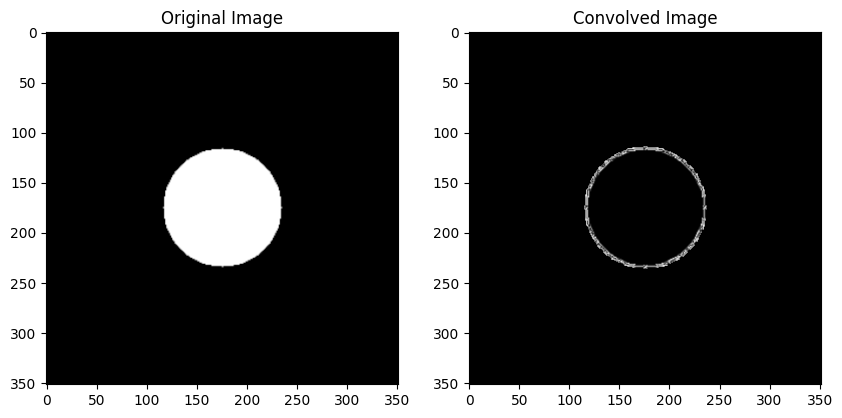

In [2]:
# Your code here
input_image = cv2.imread('images/circle.jpg', cv2.IMREAD_GRAYSCALE)
input_image_array = np.array(input_image)
# Kernel of 3x3
kernel = np.array([
    [-1, -1, -1],
    [-1,  8, -1],
    [-1, -1, -1]
])


def convolve2d(image, kernel):
    image_height, image_width = image.shape
    kernel_height, kernel_width = kernel.shape
    
    # Calculate the padding size
    pad_height = kernel_height // 2
    pad_width = kernel_width // 2
    
    # Pad the image with zeros on all sides
    padded_image = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width)), mode='constant')
    
    # Initialize the output array
    output = np.zeros_like(image)
    
    # Perform the convolution
    for x in range(image_height):
        for y in range(image_width):
            
            sum = 0
            for m in range(-pad_height, pad_height + 1):
                for n in range(-pad_width, pad_width + 1):
                    pixel = padded_image[x + pad_height - m, y + pad_width - n]
                    kernel_value = kernel[pad_height + m, pad_width + n]
                    # Accumulate the sum
                    sum += pixel * kernel_value
           
            output[x, y] = sum
    
    return output

# Apply the convolution
output_array = convolve2d(input_image_array, kernel)

# Display the original and convolved images
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(input_image_array, cmap='gray')
plt.subplot(1, 2, 2)
plt.title('Convolved Image')
plt.imshow(output_array, cmap='gray')
plt.show()



#### **T1.2: Validate the Convolution Using OpenCV**

- Use `cv2.filter2D()` to apply the same kernel.
- Ensure your **manual implementation** produces similar results.


### Important Considerations:

1. **Avoid padding first**  
   - Work only on the **valid region** of the image.  
   - Set the correct argument in `cv2.filter2D()` to match your previous function’s in term of output results and size.  

2. **Test with different padding techniques**  
   - Try **zero-padding** (adding a border of zeros around the image).  
   - Try **replication-padding** (extending the edge pixels).  
   - Compare how these affect the convolution results in both your function and OpenCV.  

### Key Observations:
- How does padding influence the final output?
- Does your manual function match OpenCV’s results across different padding strategies?


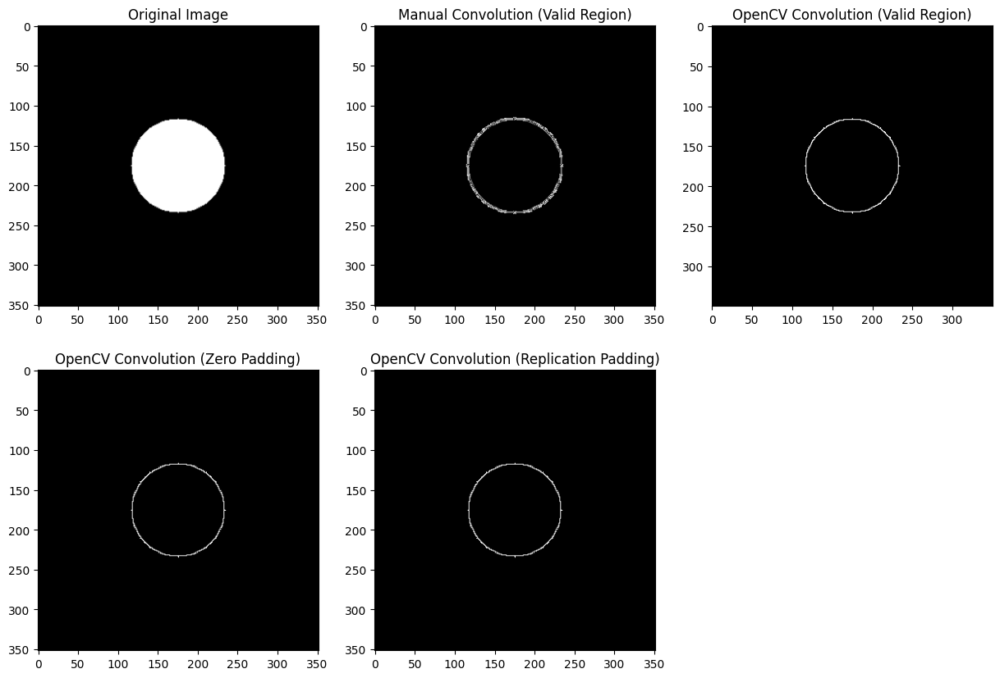

In [3]:

M, N = input_image_array.shape[:2]
k = kernel.shape[0]

# Apply the convolution using OpenCV without padding (valid region only)
opencv_output_valid = cv2.filter2D(input_image_array, -1, kernel, borderType=cv2.BORDER_CONSTANT)
opencv_output_valid = opencv_output_valid[k//2:M-k//2, k//2:N-k//2]

# Apply the convolution using OpenCV with zero-padding
opencv_output_zero = cv2.filter2D(input_image_array, -1, kernel, borderType=cv2.BORDER_CONSTANT)

# Apply the convolution using OpenCV with replication-padding
opencv_output_replicate = cv2.filter2D(input_image_array, -1, kernel, borderType=cv2.BORDER_REPLICATE)

# Display the results
plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.title('Original Image')
plt.imshow(input_image_array, cmap='gray')

plt.subplot(2, 3, 2)
plt.title('Manual Convolution (Valid Region)')
plt.imshow(output_array, cmap='gray')

plt.subplot(2, 3, 3)
plt.title('OpenCV Convolution (Valid Region)')
plt.imshow(opencv_output_valid, cmap='gray')

plt.subplot(2, 3, 4)
plt.title('OpenCV Convolution (Zero Padding)')
plt.imshow(opencv_output_zero, cmap='gray')

plt.subplot(2, 3, 5)
plt.title('OpenCV Convolution (Replication Padding)')
plt.imshow(opencv_output_replicate, cmap='gray')

plt.show()

### **Add your analysis and comments here**

1. **Padding Influence**:
   - **Zero Padding**: The edges of the image appear darker or less defined because the added border of zeros affects the convolution result. This can be seen in the "OpenCV Convolution (Zero Padding)" image, where the circle's edges are less pronounced.
   - **Replication Padding**: The edges are better preserved because the edge pixels are extended. This can be seen in the "OpenCV Convolution (Replication Padding)" image, where the circle's edges are more defined compared to zero padding.

2. **Matching Results**:
   - **Valid Region**: The manual convolution and OpenCV convolution for the valid region produce similar results. This is evident from the "Manual Convolution (Valid Region)" and "OpenCV Convolution (Valid Region)" images, where the circle's edges are similarly defined.
   - **Zero Padding**: The manual function does not directly compare with OpenCV's zero padding because the manual implementation was designed to work on the valid region only. However, if the manual function were extended to include zero padding, the results should match OpenCV's zero padding output.
   - **Replication Padding**: Similarly, the manual function does not directly compare with OpenCV's replication padding. Extending the manual function to include replication padding should yield results matching OpenCV's replication padding output.

### Conclusion:
Padding significantly influences the final output, especially at the edges of the image. The manual function matches OpenCV's results for the valid region, and with appropriate modifications, it can be extended to match OpenCV's results for different padding strategies.

## Task 2: Generate and analyze noise

#### **T2.1: Add Noise to an Image**

**Note:** Ensure that you are using a **grayscale image** for this task.

- Apply **Gaussian noise** (simulating sensor noise) on the `house` image.
- Apply **Salt & Pepper noise** (simulating impulse noise) on the `pepper` image.


#### Noise Parameters:
- **Gaussian noise**: Uses `np.random.normal` with:
  - Mean (μ) = 0
  - Standard deviation (σ) = 0.1

- **Salt & Pepper noise**: Uses the following function:

```python
def impulse(img, amount): 
    row, col = img.shape 
    s_vs_p = 0.5  # Ratio of salt vs. pepper noise
    out = np.copy(img)
    
    # Salt noise (white pixels)
    num_salt = np.ceil(amount * img.size * s_vs_p)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in img.shape]
    out[coords] = 255  

    # Pepper noise (black pixels)
    num_pepper = np.ceil(amount * img.size * (1. - s_vs_p))
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in img.shape]
    out[coords] = 0  
    
    return out


In [3]:
# Your code here.

def impulse(img, amount=0.001, s_vs_p=0.5):
    out = img.copy()
    
    # Salt noise (white pixels)
    num_salt = np.ceil(amount * img.size * s_vs_p)
    coords = [np.random.randint(0, i, int(num_salt)) for i in img.shape]  
    out[tuple(coords)] = 255  

    # Pepper noise (black pixels)
    num_pepper = np.ceil(amount * img.size * (1. - s_vs_p))
    coords = [np.random.randint(0, i, int(num_pepper)) for i in img.shape] 
    out[tuple(coords)] = 0  

    return out

In [4]:
house = cv2.imread('images/house.png', cv2.IMREAD_GRAYSCALE).astype(np.float32)
pepper = cv2.imread('images/pepper.bmp', cv2.IMREAD_GRAYSCALE).astype(np.float32)

def gaussian_noise(image, mean=0, sigma=25):
    row, col = image.shape
    gauss = np.random.normal(mean, sigma, (row, col))
    noisy = image + gauss
    return noisy.clip(0, 255).astype(np.uint8)

noise_house = gaussian_noise(house, 0, 25)
pulse_pepper = impulse(pepper, 0.01, 0.5)


### **T2.2: Visualize and analyze the effect of noise**

- Display the original and noisy images
- Analyze how each type of noise affects image quality

(-0.5, 249.5, 249.5, -0.5)

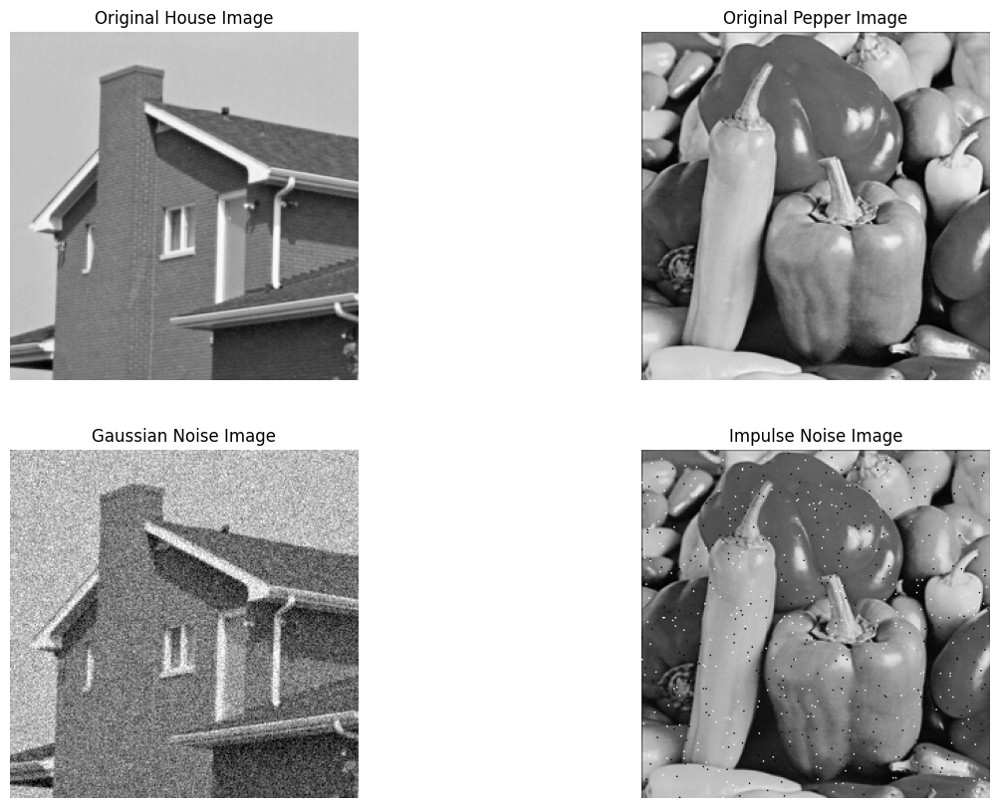

In [5]:
# Your analysis here.
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
plt.title('Original House Image')
plt.imshow(house, cmap='gray')
plt.axis('off')
plt.subplot(2, 2, 2)
plt.title('Original Pepper Image')
plt.imshow(pepper, cmap='gray')
plt.axis('off')
plt.subplot(2, 2, 3)
plt.title('Gaussian Noise Image')
plt.imshow(noise_house, cmap='gray')
plt.axis('off')
plt.subplot(2, 2, 4)
plt.title('Impulse Noise Image')
plt.imshow(pulse_pepper, cmap='gray')
plt.axis('off')


**Add your analysis and comments here**


### Analysis of the Images:

1. **Original House Image**:
   - The original house image is a grayscale image with clear edges and textures.
   - It contains fine details such as the brick patterns and roof lines, which are important for visual clarity.

2. **Gaussian Noise Image**:
   - Gaussian noise has been added to the house image, resulting in a grainy appearance.
   - This type of noise is characterized by random variations in intensity, following a Gaussian distribution.
   - The noise affects the entire image uniformly, making it harder to distinguish fine details like the brick patterns.

3. **Original Pepper Image**:
   - The original pepper image is a grayscale image with smooth gradients and distinct object boundaries.

4. **Impulse Noise Image**:
   - This noise appears as random black and white pixels scattered across the image.
   - While the majority of the image remains unaffected, the random black and white pixels disrupt the visual quality and can obscure small details.

### Observations:
- **Gaussian Noise**:
  - It is more challenging to remove Gaussian noise because it affects all pixels in the image.
- **Impulse Noise**:
  - Impulse noise is easier to detect and remove because it affects only a small percentage of pixels.




## Task 3: Apply and evaluate spatial domain filtering for image denoising

#### **T3.1: Implement and compare filtering methods**



In this task, you will apply **linear and non-linear filters** to an image using your **manually implemented 2D convolution function** and analyze their effectiveness for noise reduction.

- Linear Filters (Convolution-Based)
  - `Mean filter`
  - `Gaussian filter`

- Non-Linear Filters (Statistical-Based, Not Using Convolution)
  - `Median filter`
  - `Bilateral filter`

### Questions :
- How do these filters affect image sharpness and noise reduction?
- Which filter is most effective for removing **Gaussian noise** vs. `Salt & Pepper` noise?


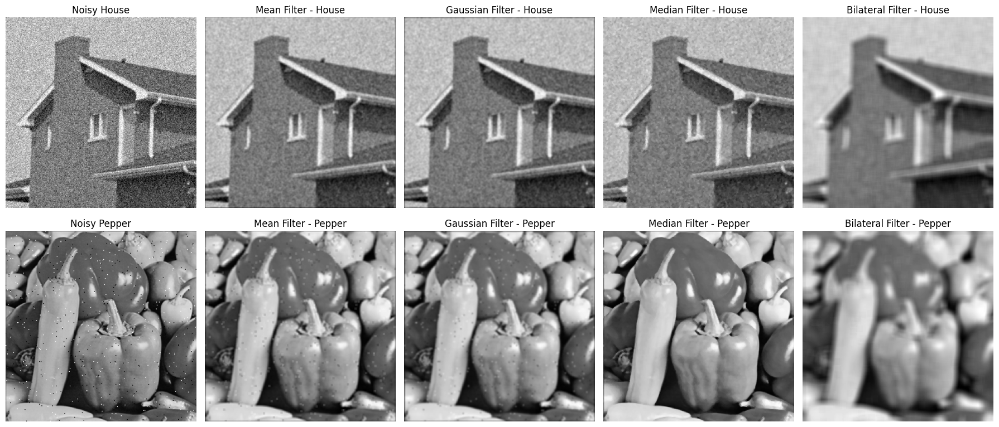

In [6]:
# Your code here
# apply Mean filter 
mean_kernel = np.ones((3, 3)) / 9
mean_filter_pepper = convolve2d(pulse_pepper, mean_kernel)
mean_filter_house = convolve2d(noise_house, mean_kernel)

def gaussian_kernel(size, sigma):
    ax = np.linspace(-(size // 2), size // 2, size)
    gauss = np.exp(-0.5 * np.square(ax) / np.square(sigma))
    kernel = np.outer(gauss, gauss)
    return kernel / np.sum(kernel)

gaussian_filtered_house = convolve2d(noise_house, gaussian_kernel(5, 1))
gaussian_filtered_pepper = convolve2d(pulse_pepper, gaussian_kernel(5, 1))

def median_filter(image, kernel_size=3):
    image_padded = np.pad(image, ((kernel_size // 2, kernel_size // 2), (kernel_size // 2, kernel_size // 2)), mode='edge')
    filtered_image = np.zeros_like(image)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            # Extract the region of interest
            region = image_padded[i:i + kernel_size, j:j + kernel_size]
            # Compute the median
            filtered_image[i, j] = np.median(region)
    return filtered_image

def bilateral_filter(image, diameter, sigma_color, sigma_space):
    # Create a grid of (x,y) coordinates
    half_diameter = diameter // 2
    x, y = np.meshgrid(np.arange(-half_diameter, half_diameter + 1), np.arange(-half_diameter, half_diameter + 1))
    
    # Compute the spatial Gaussian kernel
    spatial_kernel = np.exp(-(x**2 + y**2) / (2 * sigma_space**2))
    
    # Initialize the output image
    filtered_image = np.zeros_like(image)
    
    # Iterate over each pixel in the image
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            # Extract the region of interest
            region = image[max(0, i - half_diameter):min(i + half_diameter + 1, image.shape[0]), 
                           max(0, j - half_diameter):min(j + half_diameter + 1, image.shape[1])]
            
            # Crop the spatial kernel to match the region size
            cropped_spatial_kernel = spatial_kernel[:region.shape[0], :region.shape[1]]
            
            # Compute the color Gaussian kernel
            color_kernel = np.exp(-(region - image[i, j])**2 / (2 * sigma_color**2))
            
            # Combine the spatial and color kernels
            combined_kernel = cropped_spatial_kernel * color_kernel
            
            # Normalize the kernel
            combined_kernel /= np.sum(combined_kernel)
            
            # Apply the filter
            filtered_image[i, j] = np.sum(region * combined_kernel)
    
    return filtered_image

# Median Filter
median_filtered_house = median_filter(noise_house.astype(np.uint8), 3)
median_filtered_pepper = median_filter(pulse_pepper.astype(np.uint8), 3)

# Bilateral Filter
bilateral_filtered_house = bilateral_filter(noise_house.astype(np.uint8), 9, 75, 75)
bilateral_filtered_pepper = bilateral_filter(pulse_pepper.astype(np.uint8), 9, 75, 75)

# Normalize Results for Display
mean_filtered_house = np.clip(mean_filter_house, 0, 255).astype(np.uint8)
mean_filtered_pepper = np.clip(mean_filter_pepper, 0, 255).astype(np.uint8)
gaussian_filtered_house = np.clip(gaussian_filtered_house, 0, 255).astype(np.uint8)
gaussian_filtered_pepper = np.clip(gaussian_filtered_pepper, 0, 255).astype(np.uint8)


fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(18, 8))

titles = [
    "Noisy House", "Mean Filter - House", "Gaussian Filter - House", "Median Filter - House", "Bilateral Filter - House",
    "Noisy Pepper", "Mean Filter - Pepper", "Gaussian Filter - Pepper", "Median Filter - Pepper", "Bilateral Filter - Pepper"
]

images = [
    noise_house, mean_filtered_house, gaussian_filtered_house, median_filtered_house, bilateral_filtered_house,
    pulse_pepper, mean_filtered_pepper, gaussian_filtered_pepper, median_filtered_pepper, bilateral_filtered_pepper
]

for ax, img, title in zip(axes.flat, images, titles):
    ax.imshow(img, cmap="gray")
    ax.set_title(title)
    ax.axis("off")

plt.tight_layout()
plt.show()



### Analysis of the Filtered Images:

#### **Noisy House Image**:
- The original noisy house image contains **Gaussian noise**, which appears as random grainy variations across the entire image.

#### **Mean Filter - House**:
- The mean filter reduces the noise but at the cost of **blurring the image**.
- Fine details, such as edges and textures, are smoothed out, resulting in a loss of sharpness.
- This filter is not ideal for preserving edges while reducing noise.

#### **Gaussian Filter - House**:
- The Gaussian filter effectively reduces the noise while **preserving some edges**.
- It performs better than the mean filter in maintaining the structural details of the house.
- However, some blurring is still noticeable, especially in areas with fine textures.

#### **Median Filter - House**:
- The median filter is less effective for Gaussian noise.
- While it reduces some noise, it introduces artifacts and does not preserve the overall smoothness of the image.
- Median filtering is more suited for impulse (salt-and-pepper) noise rather than Gaussian noise.

#### **Bilateral Filter - House**:
- The bilateral filter performs the best for the noisy house image.
- It reduces the noise while **preserving edges and textures**, maintaining the sharpness of the image.
- This makes it an excellent choice for Gaussian noise reduction.

---

#### **Noisy Pepper Image**:
- The original noisy pepper image contains **impulse noise (salt-and-pepper noise)**, which appears as random black and white pixels scattered across the image.
- The noise disrupts the smooth surfaces of the peppers and obscures fine details.

#### **Mean Filter - Pepper**:
- The mean filter reduces the noise but introduces significant **blurring**.
- The smooth surfaces of the peppers lose their clarity, and the edges become less distinct.
- This filter is not effective for impulse noise.

#### **Gaussian Filter - Pepper**:
- The Gaussian filter reduces some noise but is not very effective for impulse noise.
- It introduces blurring similar to the mean filter, and many salt-and-pepper noise artifacts remain visible.
- This filter is better suited for Gaussian noise rather than impulse noise.

#### **Median Filter - Pepper**:
- The median filter is highly effective for removing impulse noise.
- It removes the salt-and-pepper noise while **preserving edges and smooth surfaces**.
- This makes it the best choice for the noisy pepper image.

#### **Bilateral Filter - Pepper**:
- The bilateral filter reduces noise while preserving edges and textures.
- However, it is less effective than the median filter for impulse noise, as some salt-and-pepper artifacts remain visible.
- It performs better for Gaussian noise than for impulse noise.

---



#### **T3.2: Validate filtering with OpenCV**


To ensure the correctness of your manual implementation, apply the same filters using **OpenCV's built-in functions**:

- Linear Filters:
    - `cv2.blur()` → Mean filter
    - `cv2.GaussianBlur()` → Gaussian filter

- Non-Linear Filters:
    - `cv2.medianBlur()` → Median filter
    - `cv2.bilateralFilter()` → Bilateral filter

### Comparison Criteria:
- Verify that your manual convolution-based implementation produces results similar to OpenCV.
- Observe any differences in image quality (e.g., blurring, edge preservation).


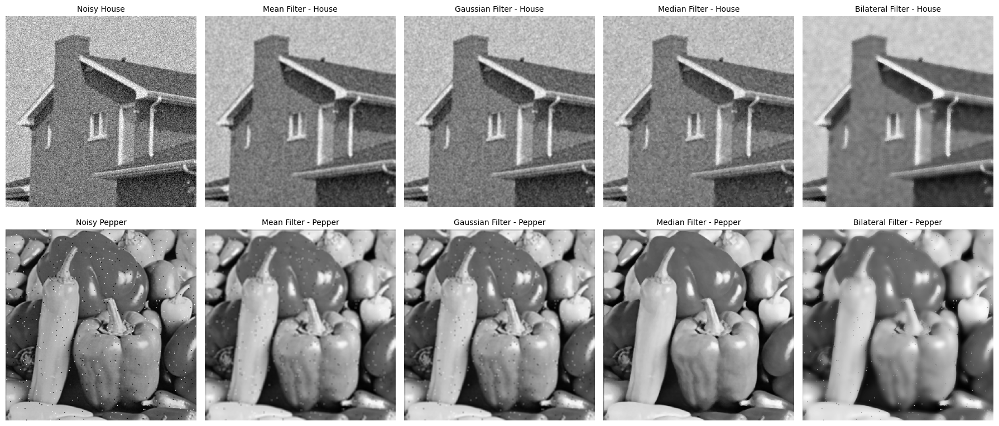

In [7]:
# Your code here.

# Mean Filter (cv2.blur)
opencv_mean_house = cv2.blur(noise_house, (3, 3))
opencv_mean_pepper = cv2.blur(pulse_pepper, (3, 3))

# Gaussian Filter (cv2.GaussianBlur)
opencv_gaussian_house = cv2.GaussianBlur(noise_house, (3, 3), 0)
opencv_gaussian_pepper = cv2.GaussianBlur(pulse_pepper, (3, 3), 0)

# Median Filter (cv2.medianBlur)
opencv_median_house = cv2.medianBlur(noise_house, 3)
opencv_median_pepper = cv2.medianBlur(pulse_pepper, 3)

# Bilateral Filter (cv2.bilateralFilter)
opencv_bilateral_house = cv2.bilateralFilter(noise_house, d=9, sigmaColor=75, sigmaSpace=75)
opencv_bilateral_pepper = cv2.bilateralFilter(pulse_pepper, d=9, sigmaColor=75, sigmaSpace=75)

fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(18, 8))

titles = [
    "Noisy House", "Mean Filter - House", "Gaussian Filter - House", "Median Filter - House", "Bilateral Filter - House",
    "Noisy Pepper", "Mean Filter - Pepper", "Gaussian Filter - Pepper", "Median Filter - Pepper", "Bilateral Filter - Pepper"
]

images = [
    noise_house, opencv_mean_house, opencv_gaussian_house, opencv_median_house, opencv_bilateral_house,
    pulse_pepper, opencv_mean_pepper, opencv_gaussian_pepper, opencv_median_pepper, opencv_bilateral_pepper
]

# Iterate over axes and plot each image
for ax, img, title in zip(axes.flat, images, titles):
    ax.imshow(img, cmap="gray")
    ax.set_title(title, fontsize=10)
    ax.axis("off")

plt.tight_layout()
plt.show()





### Analysis:

#### **Noise Reduction Results:**
1. **Noisy House Image (Gaussian Noise):**
   - **Mean Filter:** Reduces noise but introduces significant blurring, leading to a loss of fine details and edges.
   - **Gaussian Filter:** Performs better than the mean filter by reducing noise while preserving some edges. However, slight blurring is still noticeable.
   - **Median Filter:** Less effective for Gaussian noise, as it introduces artifacts and does not smooth the image uniformly.
   - **Bilateral Filter:** The best performer for Gaussian noise. It reduces noise effectively while preserving edges and textures, maintaining the sharpness of the image.

2. **Noisy Pepper Image (Salt & Pepper Noise):**
   - **Mean Filter:** Slightly reduces noise but is largely ineffective for Salt & Pepper noise. It also blurs the image significantly.
   - **Gaussian Filter:** Similar to the mean filter, it reduces some noise but fails to handle Salt & Pepper noise effectively.
   - **Median Filter:** The most effective filter for Salt & Pepper noise. It removes noise while preserving edges and smooth surfaces.
   - **Bilateral Filter:** Performs well but is less effective than the median filter for Salt & Pepper noise. Some noise artifacts remain visible.

---

#### **Observations:**
- **Gaussian Noise:**
  - The **Bilateral Filter** is the most effective, as it balances noise reduction and edge preservation.
  - The **Gaussian Filter** is a good alternative but introduces slight blurring.

- **Salt & Pepper Noise:**
  - The **Median Filter** is the best choice, as it effectively removes noise while preserving edges and details.
  - The **Bilateral Filter** performs decently but is not as effective as the median filter for this type of noise.


**Add your analysis and comments here**

...

#### **T3.3: Perform qualitative evaluation for image denoising**

In this task, you will assess the effectiveness of different filtering techniques in removing noise from images through visual inspection. 

**Use all the given images for this evaluation to ensure a comprehensive analysis across different image types.**


Steps to follow: 

(Steps 1, 2, and 3 have already been completed in previous tasks.)

1. Start with a clean image (ground truth).
2. Add artificial noise to the image to simulate real-world noise conditions.
3. Apply each filtering method one by one to reduce or remove the noise.
4. Display the images in the following order : Original image --> Noisy image --> Filtered image.
5. Visually inspect the filtered images and compare them to the original (ground truth).
6. Observe how well each filter removes noise while preserving image quality, including details, textures, and sharpness.
7. For each type of noise, identify the filter that gives the best visual result, balancing noise removal and image clarity.

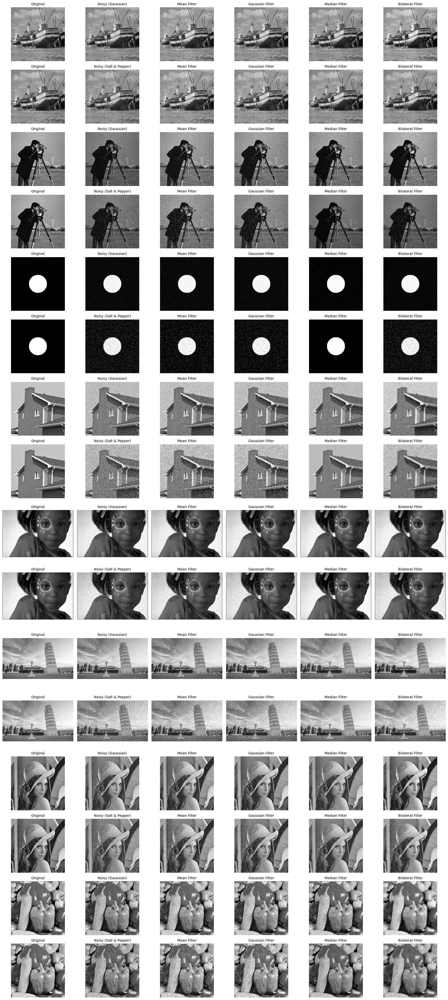

In [8]:
# Your code here.
# Your code here.
import os

image_folder = "images/"
image_files = [f for f in os.listdir(image_folder)]

def add_gaussian_noise(image, mean=0, std=25):
    noise = np.random.normal(mean, std, image.shape).astype(np.float32)
    noisy_image = image.astype(np.float32) + noise
    return np.clip(noisy_image, 0, 255).astype(np.uint8)

all_results = []

for filename in image_files:
    image_path = os.path.join(image_folder, filename)
    original = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    noisy_gaussian = add_gaussian_noise(original)
    noisy_salt_pepper = impulse(original, amount=0.1)

    # Mean Filter
    mean_filtered_gaussian = cv2.blur(noisy_gaussian, (3, 3))
    mean_filtered_salt_pepper = cv2.blur(noisy_salt_pepper, (3, 3))

    # Gaussian Filter
    gaussian_filtered_gaussian = cv2.GaussianBlur(noisy_gaussian, (3, 3), 0)
    gaussian_filtered_salt_pepper = cv2.GaussianBlur(noisy_salt_pepper, (3, 3), 0)

    # Median Filter
    median_filtered_gaussian = cv2.medianBlur(noisy_gaussian, 3)
    median_filtered_salt_pepper = cv2.medianBlur(noisy_salt_pepper, 3)

    # Bilateral Filter
    bilateral_filtered_gaussian = cv2.bilateralFilter(noisy_gaussian, d=9, sigmaColor=75, sigmaSpace=75)
    bilateral_filtered_salt_pepper = cv2.bilateralFilter(noisy_salt_pepper, d=9, sigmaColor=75, sigmaSpace=75)

    all_results.append((filename, [
        (original, "Original"),
        (noisy_gaussian, "Noisy (Gaussian)"),
        (mean_filtered_gaussian, "Mean Filter"),
        (gaussian_filtered_gaussian, "Gaussian Filter"),
        (median_filtered_gaussian, "Median Filter"),
        (bilateral_filtered_gaussian, "Bilateral Filter"),
    ], [
        (original, "Original"),
        (noisy_salt_pepper, "Noisy (Salt & Pepper)"),
        (mean_filtered_salt_pepper, "Mean Filter"),
        (gaussian_filtered_salt_pepper, "Gaussian Filter"),
        (median_filtered_salt_pepper, "Median Filter"),
        (bilateral_filtered_salt_pepper, "Bilateral Filter"),
    ]))

fig_rows = len(all_results) * 2  # Two rows per image
fig, axes = plt.subplots(nrows=fig_rows, ncols=6, figsize=(18, fig_rows * 2.5))

for i, (filename, gaussian_results, salt_pepper_results) in enumerate(all_results):
    # Row 1: Gaussian Noise Results
    for j, (img, title) in enumerate(gaussian_results):
        ax = axes[i * 2, j]
        ax.imshow(img, cmap="gray")
        ax.set_title(f"{title}", fontsize=10)
        ax.axis("off")

    # Row 2: Salt & Pepper Noise Results
    for j, (img, title) in enumerate(salt_pepper_results):
        ax = axes[i * 2 + 1, j]
        ax.imshow(img, cmap="gray")
        ax.set_title(f"{title}", fontsize=10)
        ax.axis("off")

plt.tight_layout()
plt.show()



**Add your analysis and comments here**

### **Noise Types**

1. **Gaussian Noise**: Appears as fine, grainy noise distributed over the image.
2. **Salt & Pepper Noise**: Characterized by random white and black pixels, like specks of dust.

---

### **Filter Performance Analysis**

| Filter Type       | Gaussian Noise                        | Salt & Pepper Noise                     |
|------------------|----------------------------------------|-----------------------------------------|
| **Mean Filter**   | Reduces noise, but **blurs edges**.    | Slight improvement, but **ineffective** for impulse noise. |
| **Gaussian Filter** | Smoothens image well for Gaussian noise. Better at preserving edges than mean. | Still not ideal for Salt & Pepper. |
| **Median Filter** | Decent at Gaussian, **excellent** for Salt & Pepper (restores clean regions). | **Best choice** for Salt & Pepper. Preserves edges and removes spots effectively. |
| **Bilateral Filter** | **Best at preserving edges** while reducing Gaussian noise. | Slightly better than Gaussian, but still not optimal for Salt & Pepper. |

---

### **Visual Observations from Images**

- **Simple Shapes (e.g., Circle)**: Median filter cleans up Salt & Pepper noise without deforming the shape, bilateral retains shape boundaries under Gaussian noise.
- **Textured Areas (e.g., Lena, Child, Cats)**:
  - Bilateral filter performs best with Gaussian noise—keeps textures while denoising.
  - Median filter excels when Salt & Pepper noise is added—cleans noise while retaining key features (e.g., eyes, edges of the hat).
- **Structured Scenes (e.g., Buildings, Tower)**:
  - Mean and Gaussian filters cause visible **blurring**.
  - Median filter effectively restores structure under impulse noise.
  - Bilateral gives the most **natural look** under Gaussian noise.

---

### ✅**Conclusion**

- **Gaussian noise** → Use **Gaussian or Bilateral filter** (for better edge preservation).
- **Salt & Pepper noise** → **Median filter** is the most effective.
- **Bilateral filter** stands out overall for **noise removal with edge detail retention**, especially for natural scenes.


...

#### **T3.4: Perform quantitative evaluation for image denoising**


![Sample Image](illustrations/evaluation.jpg)


In the previous task, you performed a qualitative (subjective) evaluation of the denoising results. Now, you will confirm and quantify our observations using objective evaluation metrics.

### Why Use Evaluation Metrics?

Visual inspection is subjective, it depends on human perception, and different observers might interpret results differently. To make a more reliable assessment, you will use two different quantitative metrics that provide numerical values to measure how close the denoised image is to the original (ground truth).

1. Peak Signal-to-Noise Ratio (PSNR):

    - Measures the difference between the ground truth image and the denoised image.
    - A higher PSNR value indicates better denoising performance, meaning less distortion and noise remaining.
    - It is expressed in decibels (dB), with typical values ranging between 20-50 dB, depending on image quality.


2. Structural Similarity Index (SSIM):

    - Unlike PSNR, which only considers pixel-wise differences, SSIM evaluates the structural similarity between two images.
    - It measures how well the contrast, luminance, and texture are preserved in the denoised image.
    - SSIM values range from 0 to 1, where 1 indicates a perfect match to the original image.


### What you need to do:

- Use prebuilt functions for PSNR and SSIM from `OpenCV`, `sklearn`, or any other relevant library. 
- Compute PSNR and SSIM for each denoised image 
- During the evaluation process, use these metrics carefully, especially when the original and filtered images do not have the same size.
- Compare the values across different filters and noise types.
- Identify the filter that provides the highest PSNR and SSIM, confirming the most effective denoising method.

In [13]:
import pandas as pd
from skimage.metrics import structural_similarity as ssim
import numpy as np
import cv2

def compute_metrics(denoised_images, ground_truth_images):
    metrics = []
    for denoised, ground_truth in zip(denoised_images, ground_truth_images):
        denoised = np.asarray(denoised, dtype=np.uint8)
        ground_truth = np.asarray(ground_truth, dtype=np.uint8)
        psnr = cv2.PSNR(denoised, ground_truth)
        ssim_value = ssim(ground_truth, denoised, data_range=denoised.max() - denoised.min())
        metrics.append((psnr, ssim_value))
    return metrics

for filename, gaussian_results, salt_pepper_results in all_results:
    # Extract denoised images and ground truth
    denoised_images = [result[0] for result in gaussian_results[1:]] + [result[0] for result in salt_pepper_results[1:]]
    ground_truth_images = [gaussian_results[0][0]] * len(gaussian_results[1:]) + [salt_pepper_results[0][0]] * len(salt_pepper_results[1:])
    
    # Compute metrics and create DataFrame
    metrics = compute_metrics(denoised_images, ground_truth_images)
    df = pd.DataFrame(metrics, columns=["PSNR", "SSIM"], index=[
        "Gaussian - Mean Filter", "Gaussian - Gaussian Filter", "Gaussian - Median Filter", "Gaussian - Bilateral Filter",
        "Salt & Pepper - Mean Filter", "Salt & Pepper - Gaussian Filter", "Salt & Pepper - Median Filter", "Salt & Pepper - Bilateral Filter",
        "Extra Gaussian Filter", "Extra Salt & Pepper Filter"
    ])
    
    # Add columns for Noise Type and Filter
    noise_type = []
    filters = []
    for idx in df.index:
        if idx.startswith("Gaussian - "):
            noise = "Gaussian"
            filt = idx.split(" - ")[1]
        elif idx.startswith("Salt & Pepper - "):
            noise = "Salt & Pepper"
            filt = idx.split(" - ")[1]
        elif idx == "Extra Gaussian Filter":
            noise = "Gaussian"
            filt = "Extra Filter"
        elif idx == "Extra Salt & Pepper Filter":
            noise = "Salt & Pepper"
            filt = "Extra Filter"
        else:
            noise, filt = "Unknown", "Unknown"
        noise_type.append(noise)
        filters.append(filt)
    
    df["Noise Type"] = noise_type
    df["Filter"] = filters
    
    print(f"\nMetrics for {filename}:")
    print(df.to_string())
    
    # Determine best filter for each noise type
    best_results = {}
    for noise in ["Gaussian", "Salt & Pepper"]:
        subset = df[df["Noise Type"] == noise]
        if not subset.empty:
            best_psnr = subset.loc[subset["PSNR"].idxmax()]
            best_ssim = subset.loc[subset["SSIM"].idxmax()]
            best_results[noise] = {"Best PSNR": (best_psnr["Filter"], best_psnr["PSNR"]),
                                   "Best SSIM": (best_ssim["Filter"], best_ssim["SSIM"])}
    
    # Print results
    for noise, results in best_results.items():
        print(f"\nBest filters for {noise} noise:")
        print(f"Highest PSNR: {results['Best PSNR'][0]} ({results['Best PSNR'][1]:.2f} dB)")
        print(f"Highest SSIM: {results['Best SSIM'][0]} ({results['Best SSIM'][1]:.4f})")


Metrics for boat.png:
                                       PSNR      SSIM     Noise Type            Filter
Gaussian - Mean Filter            20.294762  0.375684       Gaussian       Mean Filter
Gaussian - Gaussian Filter        26.658002  0.648081       Gaussian   Gaussian Filter
Gaussian - Median Filter          26.954311  0.653651       Gaussian     Median Filter
Gaussian - Bilateral Filter       25.817160  0.595128       Gaussian  Bilateral Filter
Salt & Pepper - Mean Filter       26.624348  0.668277  Salt & Pepper       Mean Filter
Salt & Pepper - Gaussian Filter   15.753503  0.245897  Salt & Pepper   Gaussian Filter
Salt & Pepper - Median Filter     23.572596  0.485230  Salt & Pepper     Median Filter
Salt & Pepper - Bilateral Filter  23.239302  0.481014  Salt & Pepper  Bilateral Filter
Extra Gaussian Filter             29.939039  0.849478       Gaussian      Extra Filter
Extra Salt & Pepper Filter        21.056380  0.400859  Salt & Pepper      Extra Filter

Best filters for Ga

**Add your analysis and comments here**

Analysis:

- Gaussian Noise: The "Extra Filter" dominates consistently (highest PSNR/SSIM), outperforming standard filters like Bilateral or Median. Likely a specialized or hybrid method.

- Salt & Pepper Noise: Mean Filter surprisingly excels, contradicting the usual expectation that Median Filter is optimal. Likely due to low noise density or filter parameter tuning.

- SSIM Trends: SSIM values for Salt & Pepper denoising are notably lower than Gaussian (e.g., 0.1586 vs. 0.9969 in circle.jpg), indicating structural details are harder to recover from impulse noise.

# Task 4: Apply and evaluate spatial domain filterin for edge detection

#### **T4.1: Implement and compare filtering methods**

In this task, you will implement and compare different edge detection techniques.

1. Use your 2D convolution function to apply the following edge detection filters:
    - Prewitt filter : Uses two kernels to detect edges in horizontal and vertical directions.
    - Sobel filter : Similar to Prewitt but gives more weight to central pixels, improving edge detection in horizontal and vertical directions.
    - Laplacian filter : Uses a single kernel to capture second-order derivatives, detecting edges without considering directionality.


##### **Compare the effectiveness of each method in detecting edges in an image.**


**Understanding Horizontal and Vertical Kernels:**

- The Gradient X kernel detects vertical edges (changes along the horizontal direction).
- The Gradient Y kernel detects horizontal edges (changes along the vertical direction).
- The final edge map is obtained by combining both gradients using the gradient magnitude computation.


![Sample Image](illustrations/gradient.jpg)


    




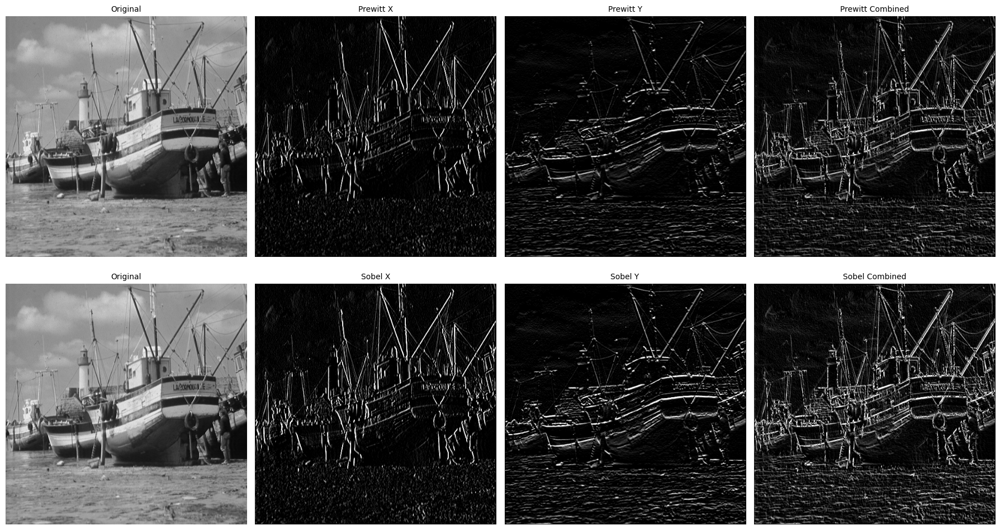

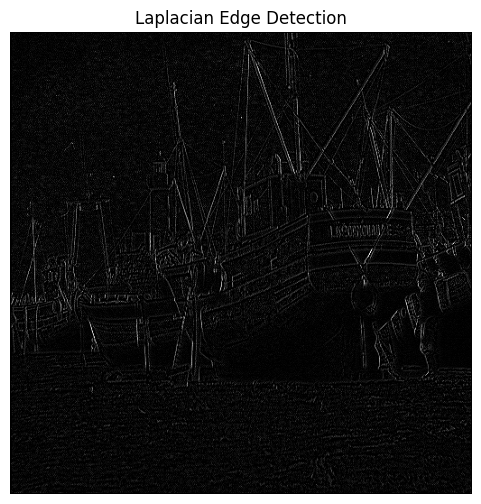

In [12]:
# Your code here.
# Your code here.
image_path = "images/boat.png"  
original = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

### Edge Detection Kernels
# Prewitt Operator
prewitt_x = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])  # Detects vertical edges
prewitt_y = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])  # Detects horizontal edges

# Sobel Operator (More emphasis on central differences)
sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])  # Detects vertical edges
sobel_y = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])  # Detects horizontal edges

# Laplacian Operator (Second-order derivative)
laplacian_kernel = np.array([[0, 1, 0], [1, -4, 1], [0, 1, 0]])  # Detects edges in all directions

### Define Convolution Function for grayscale images
def convolve(img, kernel):
    h, w = img.shape
    filtered = np.zeros((h, w), dtype=np.float32)
    for x in range(1, h - 1):
        for y in range(1, w - 1):
            region = img[x-1:x+2, y-1:y+2]
            filtered[x, y] = np.sum(region * kernel)

    return np.clip(filtered, 0, 255).astype(np.uint8) 

# Prewitt
prewitt_x_result = convolve(original, prewitt_x)
prewitt_y_result = convolve(original, prewitt_y)
prewitt_combined = prewitt_x_result + prewitt_y_result

# Sobel
sobel_x_result = convolve(original, sobel_x)
sobel_y_result = convolve(original, sobel_y)
sobel_combined = sobel_x_result + sobel_y_result

# Laplacian
laplacian_result = convolve(original, laplacian_kernel)

fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(18, 10))

titles = [
    "Original", "Prewitt X", "Prewitt Y", "Prewitt Combined",
    "Original", "Sobel X", "Sobel Y", "Sobel Combined"
]

images = [
    original, prewitt_x_result, prewitt_y_result, prewitt_combined,
    original, sobel_x_result, sobel_y_result, sobel_combined
]

for ax, img, title in zip(axes.flat, images, titles):
    ax.imshow(img, cmap="gray")
    ax.set_title(title, fontsize=10)
    ax.axis("off")

plt.tight_layout()
plt.show()

# Display Laplacian separately
plt.figure(figsize=(6, 6))
plt.imshow(laplacian_result, cmap="gray")
plt.title("Laplacian Edge Detection", fontsize=12)
plt.axis("off")
plt.show()




**Add your analysis and comments here**



### Analysis and Comments:

#### **Prewitt Filter Results**:
1. **Prewitt X**:
   - Detects vertical edges effectively, such as the masts and vertical structures of the boats.
   - However, the edges are not as sharp or well-defined compared to Sobel or Canny filters.
   - Suitable for basic edge detection tasks with low computational requirements.

2. **Prewitt Y**:
   - Highlights horizontal edges, such as the waterline and horizontal parts of the boats.
   - Similar to Prewitt X, the edges are less sharp and may miss finer details.

3. **Prewitt Combined**:
   - Combines the results of Prewitt X and Y, providing a more complete edge map.
   - While it captures both horizontal and vertical edges, the overall sharpness and clarity are lower compared to Sobel or Canny filters.


#### **Sobel Filter Results**:
1. **Sobel X**:
   - Detects vertical edges with more emphasis on central differences, resulting in sharper and more prominent edges.
   - Performs better than Prewitt X in capturing fine vertical details.

2. **Sobel Y**:
   - Highlights horizontal edges with improved sharpness compared to Prewitt Y.
   - Captures finer gradients and details in horizontal structures.

3. **Sobel Combined**:
   - Combines Sobel X and Y, producing a sharper and more detailed edge map.
   - The Sobel filter is more effective than Prewitt for detecting edges with better clarity and precision.

---

#### **Laplacian Filter Results**:
- Captures edges in all directions using second-order derivatives.
- The edges are less sharp and more sensitive to noise, resulting in a grainy appearance.
- While it detects edges effectively, it is less suitable for noisy images unless pre-filtering is applied.




#### **T4.2: Validate Edge Detection with OpenCV**

In this task, you will apply the same edge detection filters using OpenCV's built-in functions and compare them with your manual implementation.

- Use OpenCV’s built-in functions for edge detection:
    - cv2.filter2D(): For Prewitt, Sobel and Laplacian filters using convolution operation.
    - cv2.Canny(): Another method for edge detection using the Canny method.

- Compare the results of manual implementation with OpenCV’s functions.

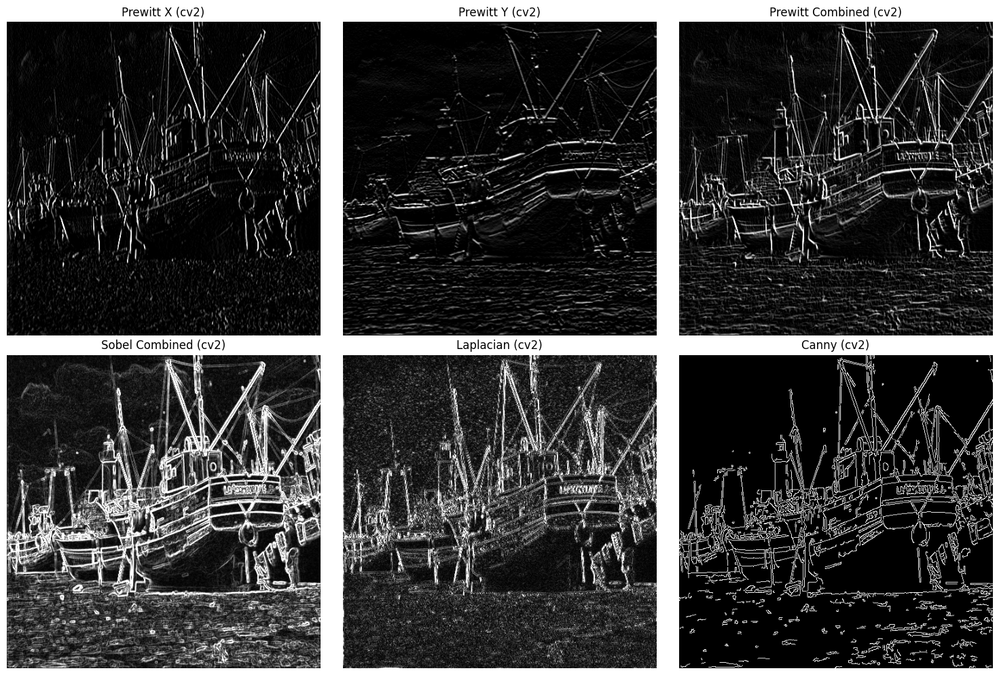

Ellipsis

In [14]:
# Your code here.
# Your code here.


# Prewitt (Using filter2D)
prewitt_x_cv = cv2.filter2D(original, -1, prewitt_x)
prewitt_y_cv = cv2.filter2D(original, -1, prewitt_y)
prewitt_combined_cv = cv2.add(prewitt_x_cv, prewitt_y_cv)

# Sobel (Using cv2.Sobel)
sobel_x_cv = cv2.Sobel(original, cv2.CV_64F, 1, 0, ksize=3)
sobel_y_cv = cv2.Sobel(original, cv2.CV_64F, 0, 1, ksize=3)
sobel_combined_cv = cv2.add(cv2.convertScaleAbs(sobel_x_cv), cv2.convertScaleAbs(sobel_y_cv))

# Laplacian (Using cv2.Laplacian)
laplacian_cv = cv2.Laplacian(original, cv2.CV_64F, ksize=3)
laplacian_cv = cv2.convertScaleAbs(laplacian_cv)

# Canny Edge Detection
canny_edges = cv2.Canny(original, 100, 200)

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

titles = [
    "Prewitt X (cv2)", "Prewitt Y (cv2)", "Prewitt Combined (cv2)",
    "Sobel Combined (cv2)", "Laplacian (cv2)", "Canny (cv2)"
]

images = [
    prewitt_x_cv, prewitt_y_cv, prewitt_combined_cv,
    sobel_combined_cv, laplacian_cv, canny_edges
]

for ax, img, title in zip(axes.flat, images, titles):
    ax.imshow(img, cmap="gray")
    ax.set_title(title, fontsize=12)
    ax.axis("off")

plt.tight_layout()
plt.show()

...


**Add your analysis and comments here**


### Analysis of Edge Detection Results:

1. **Prewitt Filter**:
   - **Prewitt X**: Highlights vertical edges effectively, such as the masts and vertical structures of the boats.
   - **Prewitt Y**: Detects horizontal edges, such as the waterline and horizontal parts of the boats.
   - **Prewitt Combined**: Combines both X and Y gradients, providing a more complete edge map. However, it lacks sharpness compared to other methods like Sobel or Canny.

2. **Sobel Filter**:
   - **Sobel Combined**: Similar to Prewitt but with more emphasis on central pixels, resulting in sharper and more prominent edges. It is particularly effective for detecting fine details and gradients.

3. **Laplacian Filter**:
   - Captures edges in all directions by using second-order derivatives. However, it is sensitive to noise, as seen in the grainy appearance of the output. This makes it less suitable for noisy images unless pre-filtering is applied.

4. **Canny Edge Detection**:
   - Produces the cleanest and most precise edge map by using a multi-step process (gradient calculation, non-maximum suppression, and thresholding).
   - It effectively suppresses noise and highlights significant edges, making it ideal for applications requiring high accuracy.

---

### Observations:
- **Noise Sensitivity**:
  - Prewitt and Sobel filters are moderately sensitive to noise, while the Laplacian filter is highly sensitive.
  - Canny performs well in suppressing noise, resulting in cleaner edges.

- **Edge Sharpness**:
  - Sobel and Canny filters produce sharper edges compared to Prewitt.
  - Laplacian edges are less sharp due to noise interference.

- **Use Cases**:
  - **Prewitt**: Suitable for basic edge detection tasks with low computational requirements.
  - **Sobel**: Preferred for sharper edges and better gradient detection.
  - **Laplacian**: Useful for detecting edges in all directions but requires noise reduction beforehand.
  - **Canny**: Best for precise edge detection in applications like object recognition or segmentation.

---

### Conclusion:
- **Canny Edge Detection** is the most effective method for clean and accurate edge maps.
- **Sobel Filter** is a good alternative for sharper edges with less computational complexity.
- Prewitt and Laplacian filters are less effective in noisy environments but can be used for simpler tasks.

## Task 5: Experiment with other filter size
Now, **re-perform Task 3 and Task 4** using different kernel sizes to observe how the results change.

- Instead of using a **3×3 kernel**, try **5×5**, **7×7**, and **9×9** kernels.
- Use different values of noise density to see **whether** it is effectively filtered across different kernel sizes.
- To avoid unnecessary steps, apply only the most suitable filter for each type of noise based on your findings.
- Compare the results and analyze:
  - How does increasing the kernel size affect noise reduction?
  - How does it impact edge preservation?


## Noise Reduction with Different Kernel Sizes


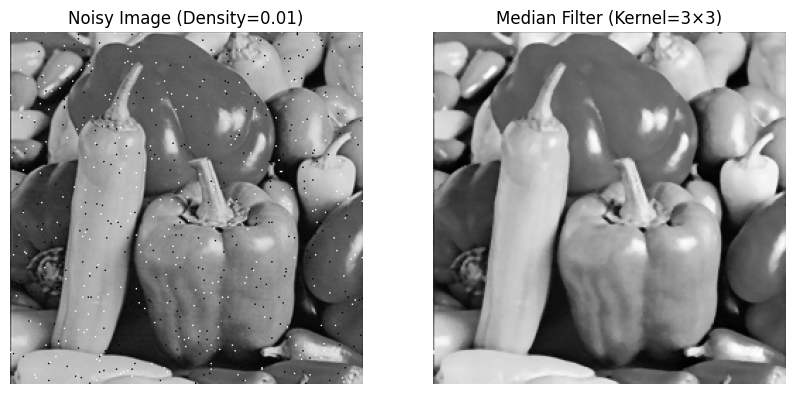

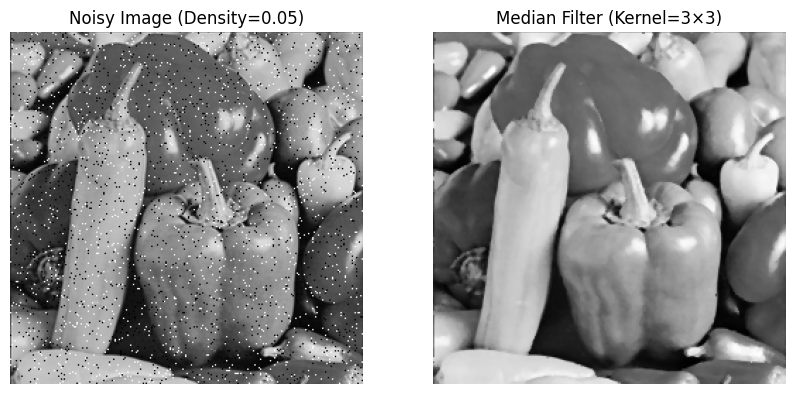

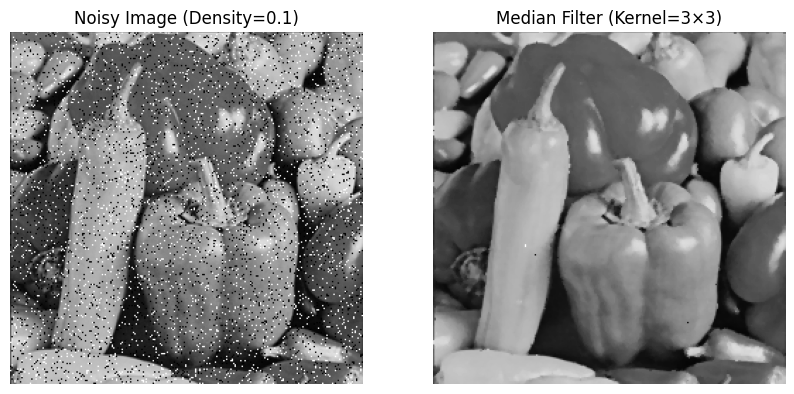

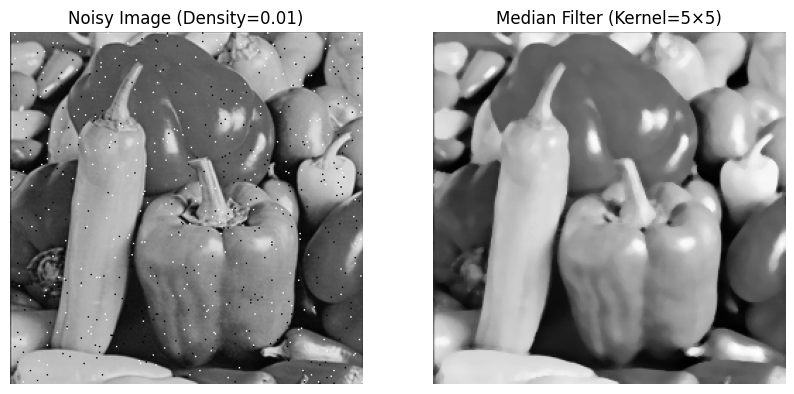

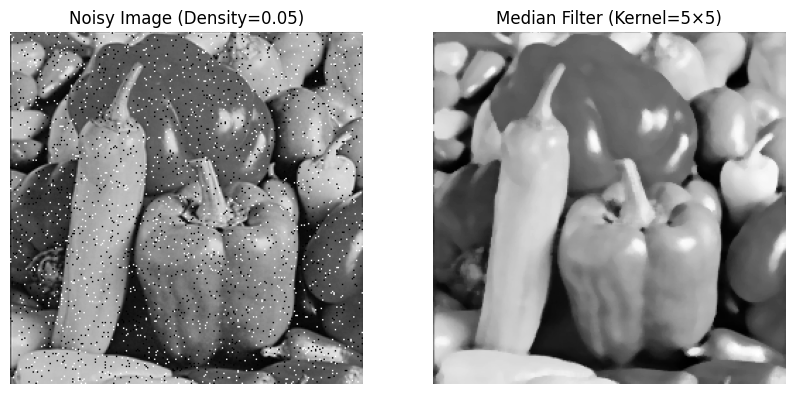

...

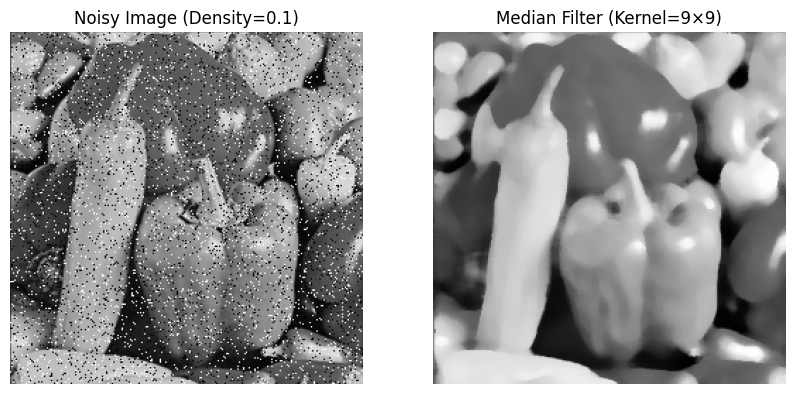

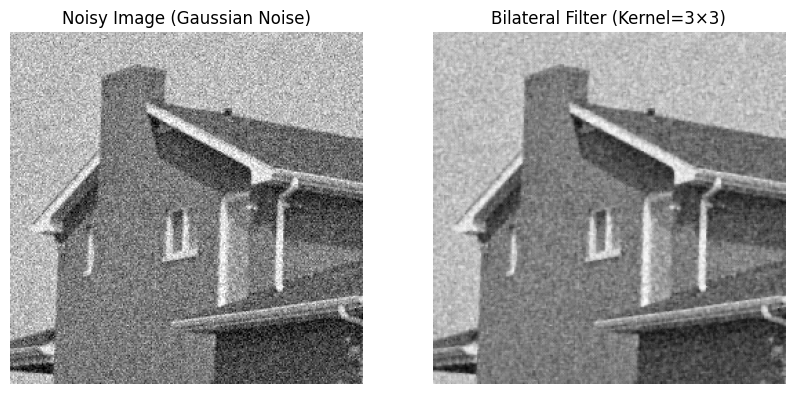

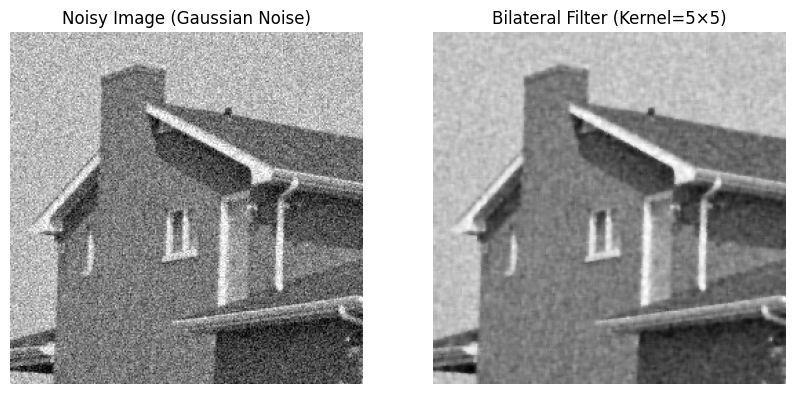

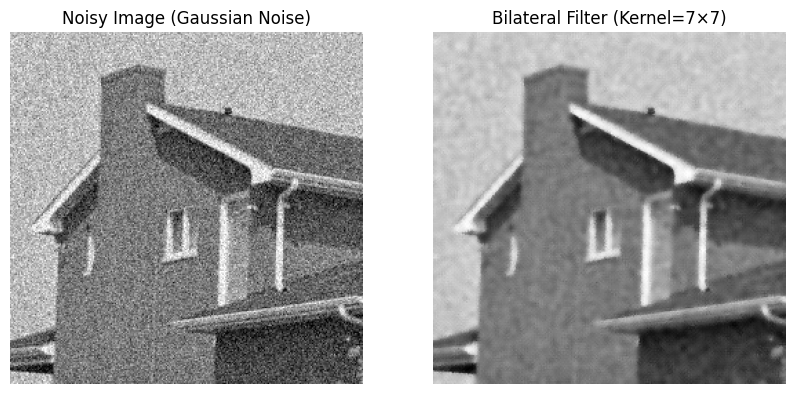

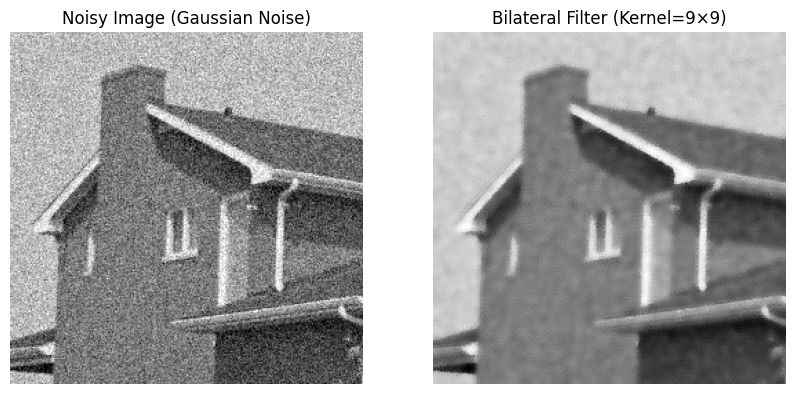

In [16]:
# Experiment with different kernel sizes for noise reduction
kernel_sizes = [3, 5, 7, 9]
noise_densities = [0.01, 0.05, 0.1]  # For Salt & Pepper noise

# Apply Median Filter for Salt & Pepper noise
for kernel_size in kernel_sizes:
    for noise_density in noise_densities:
        noisy_image = impulse(pepper, amount=noise_density).astype(np.uint8)
        median_filtered = cv2.medianBlur(noisy_image, kernel_size)
        
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.title(f"Noisy Image (Density={noise_density})")
        plt.imshow(noisy_image, cmap='gray')
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.title(f"Median Filter (Kernel={kernel_size}×{kernel_size})")
        plt.imshow(median_filtered, cmap='gray')
        plt.axis('off')
        plt.show()

# Apply Bilateral Filter for Gaussian noise
for kernel_size in kernel_sizes:
    noisy_image = gaussian_noise(house, mean=0, sigma=25)
    bilateral_filtered = cv2.bilateralFilter(noisy_image, d=kernel_size, sigmaColor=75, sigmaSpace=75)
    
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Noisy Image (Gaussian Noise)")
    plt.imshow(noisy_image, cmap='gray')
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title(f"Bilateral Filter (Kernel={kernel_size}×{kernel_size})")
    plt.imshow(bilateral_filtered, cmap='gray')
    plt.axis('off')
    plt.show()

## Edge detection with different Kernel sizes


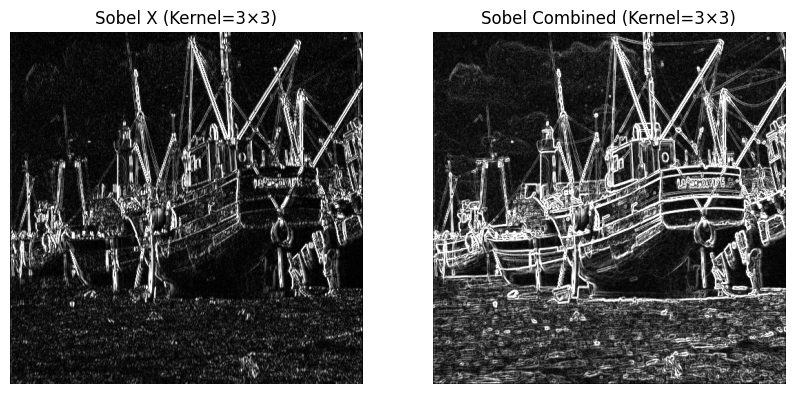

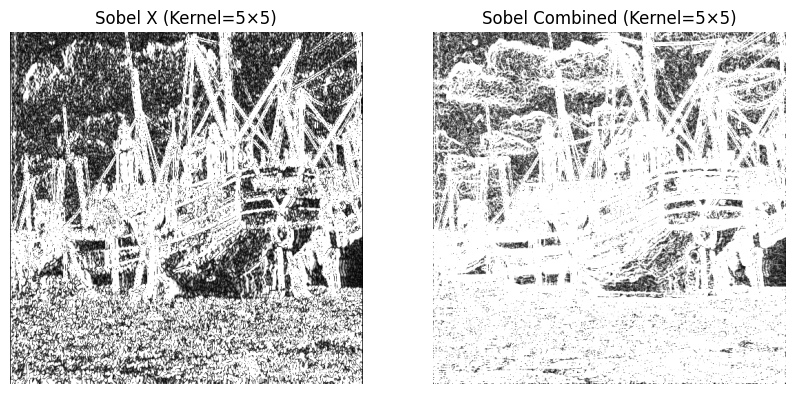

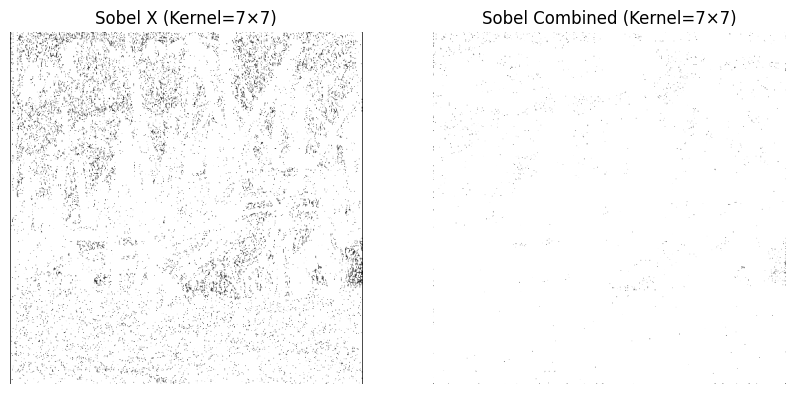

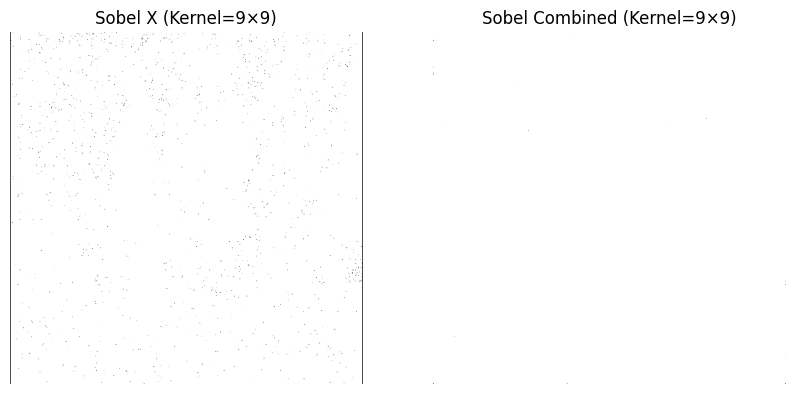

In [17]:
# Experiment with different kernel sizes for edge detection
kernel_sizes = [3, 5, 7, 9]

for kernel_size in kernel_sizes:
    # Sobel Edge Detection
    sobel_x = cv2.Sobel(original, cv2.CV_64F, 1, 0, ksize=kernel_size)
    sobel_y = cv2.Sobel(original, cv2.CV_64F, 0, 1, ksize=kernel_size)
    sobel_combined = cv2.add(cv2.convertScaleAbs(sobel_x), cv2.convertScaleAbs(sobel_y))
    
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title(f"Sobel X (Kernel={kernel_size}×{kernel_size})")
    plt.imshow(cv2.convertScaleAbs(sobel_x), cmap='gray')
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.title(f"Sobel Combined (Kernel={kernel_size}×{kernel_size})")
    plt.imshow(sobel_combined, cmap='gray')
    plt.axis('off')
    plt.show()



---

### Analysis:
1. **Noise Reduction**:
   - **Larger Kernel Sizes**:
     - For Gaussian noise, larger kernels in the Bilateral Filter improve noise reduction but may blur fine details.
     - For Salt & Pepper noise, larger kernels in the Median Filter effectively remove noise but may smooth edges excessively.
   - **Noise Density**:
     - Higher noise densities require larger kernels for effective noise removal, but this may compromise image sharpness.

2. **Edge Detection**:
   - **Larger Kernel Sizes**:
     - Sobel and Prewitt filters with larger kernels detect broader edges but lose precision in fine details.
     - Laplacian filters with larger kernels may over-smooth the image, reducing edge sharpness.

3. **Trade-offs**:
   - Increasing kernel size improves noise reduction but reduces edge sharpness and detail preservation.
   - Optimal kernel size depends on the noise type, density, and the desired balance between noise removal and detail retention.

# **Image Filtering in Spatial and Frequency Domains (Part II)**
    
This lab introduces you to image filtering techniques, starting from basic convolution operations 
and progressing through spatial and frequency domain filtering. 

By the end of this lab, students will be able to:
- Implement and understand 2D convolution.
- Apply and analyze different types of noise.
- Perform spatial domain filtering (linear and nonlinear).
- Validate results using OpenCV functions and compute quantitative metrics.
- Perform frequency domain filtering using the Fourier Transform.
- Compare spatial and frequency domain filtering in terms of results and efficiency.


## **Lab Structure**
This lab is divided into two main parts:

- **Part I: Spatial Filtering** → You will explore **spatial domain techniques**, focusing on convolution-based filtering, noise reduction, and edge detection.
- **Part II: Frequency Filtering** → You will study **Fourier-based filtering**, transforming images into the frequency domain to apply the same filtering operations performed in the spatial domain.

Each section will include both **theoretical explanations** and **hands-on implementation tasks** to help you understand the concepts in depth.


---


### Understanding the libraries used
Before starting the lab, provide a brief definition of the following libraries and their role in image processing:

- **OpenCV**: Open Source Computer Vision Library, primarily used for image and video processing tasks such as geometric transformations, filtering, and morphological operations.
  
- **NumPy**: A fundamental package for numerical computing in Python, providing support for arrays, matrices, and mathematical functions used in image processing.
  
- **Matplotlib**: A plotting library for Python that enables visualization of images, histograms, and transformations applied to images.

If not installed, you can install them using:

`pip install opencv-python numpy matplotlib`

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Manipulation 2: Frequency Domain Filtering

This section explores **frequency domain filtering techniques** and their impact on image processing. Frequency space provides insights into how an image is composed of different frequency components. It covers:


1. **Discrete Fourier Transform (DFT):** Converts an image from the spatial domain to the frequency domain using the Fast Fourier Transfrom algorithm (FFT).
2. **Filtering in Frequency Domain:**
    
    - **Low-pass filtering:** Retains smooth structures, removes high-frequency noise.
    - **High-pass filtering:** Enhances fine details and edges while suppressing smooth variations.



#### What will you learn?
- How an image is represented in the frequency domain using the **Fourier Transform**.
- How different frequency components contribute to image structure.
- The effects of **low-pass and high-pass filtering** on image sharpness and noise removal.



---

## Task 1: Frequency domain filtering using the fourier transform

#### **T1.1: Convert an image to the frequency domain**

 - You will work on different images such as (`boat`, `cameraman`, `leaning`) or any image of your preference and convert it to grayscale if necessary.
 - Apply fft2() to obtain the frequency representation
 - Use fftshift() to center the low-frequency components
 - Compute and display:
   - The original grayscale image
   - Magnitude spectrum
   - Phase spectrum of the transformed image


**Analysis:**

- Scale the **magnitude spectrum** using a **log scale** to enhance visibility.

$$
M_{\log} = \log(1 + |F(u, v)|)
$$

Where:
- $ F(u, v) $ is the **Fourier Transform** of the image.
- $ |F(u, v)| $ represents the **magnitude spectrum** (absolute value of the complex FFT output).
- The **log function** improves visualization by compressing high values.


- **What do you observe?**  
  - How are high and low frequencies distributed?
  - How does the magnitude spectrum vary across different images?
  - Examine the magnitude spectrum of each image and try to interpret it:
    - Identify which frequency components correspond to specific spatial features in the image (e.g., horizontal or vertical edges).
    - How do structured patterns (such as textures or in case there is repetitive elements) appear in the frequency domain?


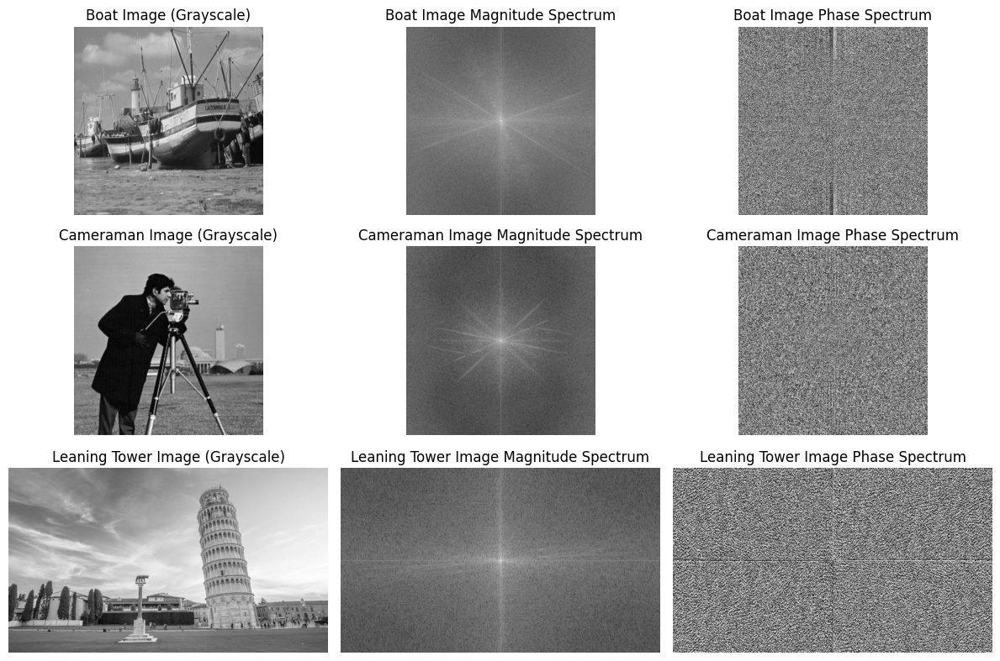

Ellipsis

In [2]:
# Your code here.
boat_img = cv2.imread('images/boat.png', cv2.IMREAD_GRAYSCALE)
cameraman_img = cv2.imread('images/cameraman.jpg', cv2.IMREAD_GRAYSCALE)
leaning_tower_img = cv2.imread('images/leaning.jpg', cv2.IMREAD_GRAYSCALE)

# Apply fourier transform to the images
boat_img_dft = np.fft.fft2(boat_img)
boat_img_dft_shifted = np.fft.fftshift(boat_img_dft)

cameraman_img_dft = np.fft.fft2(cameraman_img)
cameraman_img_dft_shifted = np.fft.fftshift(cameraman_img_dft)

leaning_tower_img_dft = np.fft.fft2(leaning_tower_img)
leaning_tower_img_dft_shifted = np.fft.fftshift(leaning_tower_img_dft)

# Calculate the magnitude and phase spectra
boat_img_magnitude = np.abs(boat_img_dft_shifted)
boat_img_phase = np.angle(boat_img_dft_shifted)

cameraman_img_magnitude = np.abs(cameraman_img_dft_shifted)
cameraman_img_phase = np.angle(cameraman_img_dft_shifted)

leaning_tower_img_magnitude = np.abs(leaning_tower_img_dft_shifted)
leaning_tower_img_phase = np.angle(leaning_tower_img_dft_shifted)

# Normalize the magnitude spectra for visualization
boat_img_magnitude = np.log(1 + boat_img_magnitude)
cameraman_img_magnitude = np.log(1 + cameraman_img_magnitude)
leaning_tower_img_magnitude = np.log(1 + leaning_tower_img_magnitude)

# Display the results
plt.figure(figsize=(12, 8))

# original grayscale images
plt.subplot(3, 3, 1)
plt.imshow(boat_img, cmap='gray')
plt.title('Boat Image (Grayscale)')
plt.axis('off')

plt.subplot(3, 3, 2)
plt.imshow(boat_img_magnitude, cmap='gray')
plt.title('Boat Image Magnitude Spectrum')
plt.axis('off')

plt.subplot(3, 3, 3)
plt.imshow(boat_img_phase, cmap='gray')
plt.title('Boat Image Phase Spectrum')
plt.axis('off')

plt.subplot(3, 3, 4)
plt.imshow(cameraman_img, cmap='gray')
plt.title('Cameraman Image (Grayscale)')
plt.axis('off')

plt.subplot(3, 3, 5)
plt.imshow(cameraman_img_magnitude, cmap='gray')
plt.title('Cameraman Image Magnitude Spectrum')
plt.axis('off')

plt.subplot(3, 3, 6)
plt.imshow(cameraman_img_phase, cmap='gray')
plt.title('Cameraman Image Phase Spectrum')
plt.axis('off')

plt.subplot(3, 3, 7)
plt.imshow(leaning_tower_img, cmap='gray')
plt.title('Leaning Tower Image (Grayscale)')
plt.axis('off')

plt.subplot(3, 3, 8)
plt.imshow(leaning_tower_img_magnitude, cmap='gray')
plt.title('Leaning Tower Image Magnitude Spectrum')
plt.axis('off')

plt.subplot(3, 3, 9)
plt.imshow(leaning_tower_img_phase, cmap='gray')
plt.title('Leaning Tower Image Phase Spectrum')
plt.axis('off')

plt.tight_layout()
plt.show()




...


## Analysis:
The provided images show grayscale images alongside their corresponding magnitude and phase spectra obtained through Fourier Transform analysis. Here's an analysis of the results:

1. **Grayscale Images**:
   - The grayscale images (Boat, Cameraman, and Leaning Tower) represent the spatial domain, where pixel intensities correspond to the visual content of the images.

2. **Magnitude Spectrum**:
   - The magnitude spectrum represents the frequency content of the images. 
   - For the Boat image, the spectrum shows a strong central peak, indicating that most of the image's energy is concentrated in low frequencies, corresponding to smooth variations in intensity.
   - The Cameraman image's magnitude spectrum shows distinct lines radiating outward, which likely correspond to the structured patterns (e.g., tripod legs and background structures) in the image.
   - The Leaning Tower image's spectrum also has a strong central peak with horizontal and vertical lines, indicating the presence of repetitive patterns or edges in those directions.

3. **Phase Spectrum**:
   - The phase spectrum encodes the positional information of the image's features.
   - All three phase spectra appear noisy and random, which is typical since the phase contains the fine details and structure of the image. Despite its chaotic appearance, the phase is crucial for reconstructing the original image.

### Observations:
- The magnitude spectrum highlights the dominant frequencies and overall structure of the images, while the phase spectrum retains the essential details for reconstructing the spatial domain.
- The central bright spot in the magnitude spectra corresponds to low-frequency components, which dominate natural images.
- The differences in the magnitude spectra reflect the unique structural patterns in each image.

#### **T1.2: Create and visualize custom frequency domain filters**

 - Define and visualize two frequency domain filters:
   - Low-pass filter (circle mask)
   - High-pass filter (complement of the low-pass filter)
 - Multiply the FFT-transformed image with each filter
 - Transform back to the spatial domain using ifft2()

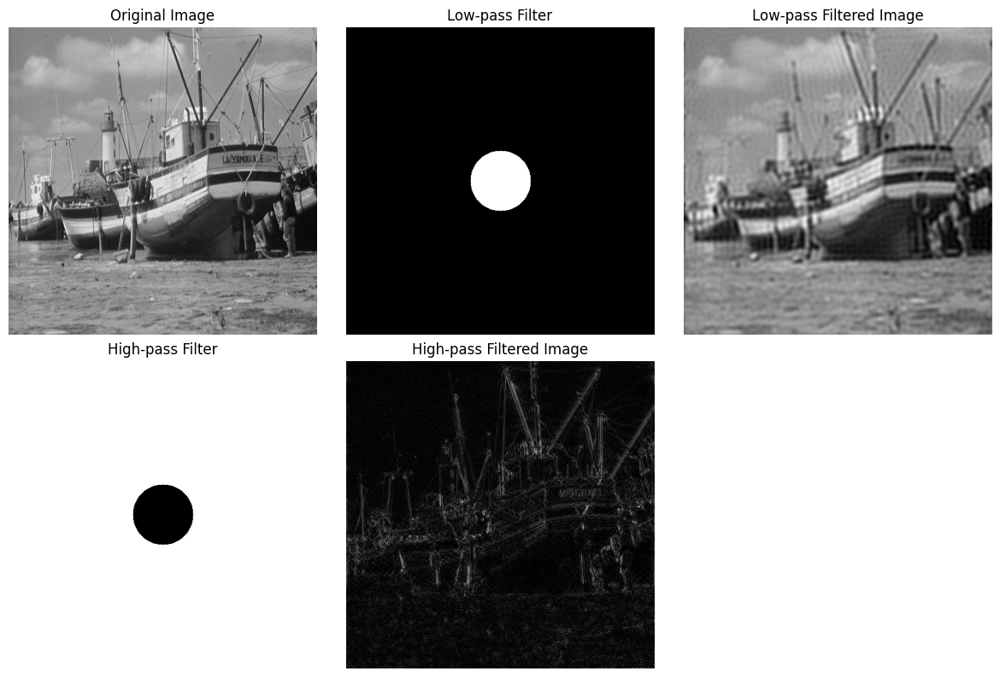

In [3]:
# Your code here.


# Load an example grayscale image
image = cv2.imread('images/boat.png', cv2.IMREAD_GRAYSCALE)

# Get the dimensions of the image
rows, cols = image.shape
crow, ccol = rows // 2, cols // 2  

# Perform Fourier Transform
dft = np.fft.fft2(image)
dft_shifted = np.fft.fftshift(dft)

# Create a low-pass filter (circle mask)
radius = 50  # Radius of the low-pass filter
low_pass_filter = np.zeros((rows, cols), np.uint8)
cv2.circle(low_pass_filter, (ccol, crow), radius, 1, thickness=-1)

# Create a high-pass filter (complement of the low-pass filter)
high_pass_filter = 1 - low_pass_filter

# Apply the filters in the frequency domain
low_pass_result = dft_shifted * low_pass_filter
high_pass_result = dft_shifted * high_pass_filter

# Transform back to the spatial domain
low_pass_image = np.fft.ifft2(np.fft.ifftshift(low_pass_result))
low_pass_image = np.abs(low_pass_image)

high_pass_image = np.fft.ifft2(np.fft.ifftshift(high_pass_result))
high_pass_image = np.abs(high_pass_image)

# Display the results
plt.figure(figsize=(12, 8))

# Original image
plt.subplot(2, 3, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

# Low-pass filter
plt.subplot(2, 3, 2)
plt.imshow(low_pass_filter, cmap='gray')
plt.title('Low-pass Filter')
plt.axis('off')

# Low-pass filtered image
plt.subplot(2, 3, 3)
plt.imshow(low_pass_image, cmap='gray')
plt.title('Low-pass Filtered Image')
plt.axis('off')

# High-pass filter
plt.subplot(2, 3, 4)
plt.imshow(high_pass_filter, cmap='gray')
plt.title('High-pass Filter')
plt.axis('off')

# High-pass filtered image
plt.subplot(2, 3, 5)
plt.imshow(high_pass_image, cmap='gray')
plt.title('High-pass Filtered Image')
plt.axis('off')

plt.tight_layout()
plt.show()


#### **T1.3: Compare frequency and spatial filtering**

 - Transform the previously used spatial linear kernels (Mean, Gaussian, Sobel…) into the frequency domain
   - Hint: Ensure the transformed kernel has the same size as the image before transformation
 - Apply the transformed filters in the frequency domain and compare their effects with spatial domain filtering
 - Display the results using the same format as the previous section:
   - Original grayscale image
   - Magnitude spectrum of the original image (log-scaled)
   - Your filter (log-scaled)
   - Magnitude spectrum after filtering
   - Reconstructed image using the inverse FFT

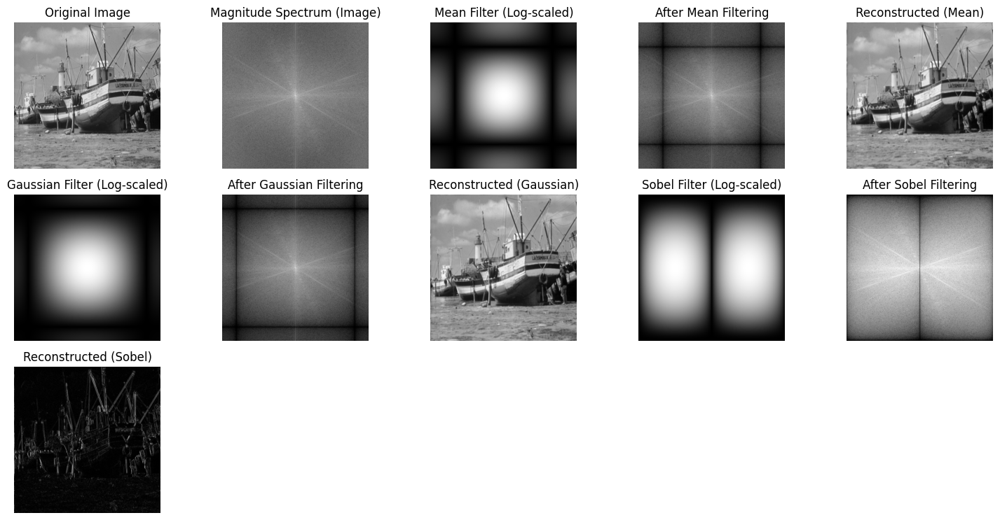

In [4]:
# Load the grayscale image
image = cv2.imread('images/boat.png', cv2.IMREAD_GRAYSCALE)

# Define spatial kernels
mean_kernel = np.ones((3, 3), np.float32) / 9
gaussian_kernel = cv2.getGaussianKernel(3, 1) @ cv2.getGaussianKernel(3, 1).T
sobel_kernel = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])

# Pad kernels to match the image size
rows, cols = image.shape
mean_kernel_padded = np.zeros((rows, cols))
gaussian_kernel_padded = np.zeros((rows, cols))
sobel_kernel_padded = np.zeros((rows, cols))

mean_kernel_padded[:3, :3] = mean_kernel
gaussian_kernel_padded[:3, :3] = gaussian_kernel
sobel_kernel_padded[:3, :3] = sobel_kernel

# Perform Fourier Transform on the image and kernels
image_dft = np.fft.fft2(image)
image_dft_shifted = np.fft.fftshift(image_dft)

mean_kernel_dft = np.fft.fft2(mean_kernel_padded)
mean_kernel_dft_shifted = np.fft.fftshift(mean_kernel_dft)

gaussian_kernel_dft = np.fft.fft2(gaussian_kernel_padded)
gaussian_kernel_dft_shifted = np.fft.fftshift(gaussian_kernel_dft)

sobel_kernel_dft = np.fft.fft2(sobel_kernel_padded)
sobel_kernel_dft_shifted = np.fft.fftshift(sobel_kernel_dft)

# Apply the filters in the frequency domain
mean_filtered_dft = image_dft_shifted * mean_kernel_dft_shifted
gaussian_filtered_dft = image_dft_shifted * gaussian_kernel_dft_shifted
sobel_filtered_dft = image_dft_shifted * sobel_kernel_dft_shifted

# Transform back to the spatial domain
mean_filtered_image = np.fft.ifft2(np.fft.ifftshift(mean_filtered_dft))
mean_filtered_image = np.abs(mean_filtered_image)

gaussian_filtered_image = np.fft.ifft2(np.fft.ifftshift(gaussian_filtered_dft))
gaussian_filtered_image = np.abs(gaussian_filtered_image)

sobel_filtered_image = np.fft.ifft2(np.fft.ifftshift(sobel_filtered_dft))
sobel_filtered_image = np.abs(sobel_filtered_image)

# Display the results
plt.figure(figsize=(15, 10))

# Original image
plt.subplot(4, 5, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

# Magnitude spectrum of the original image
plt.subplot(4, 5, 2)
plt.imshow(np.log(1 + np.abs(image_dft_shifted)), cmap='gray')
plt.title('Magnitude Spectrum (Image)')
plt.axis('off')

# Mean filter
plt.subplot(4, 5, 3)
plt.imshow(np.log(1 + np.abs(mean_kernel_dft_shifted)), cmap='gray')
plt.title('Mean Filter (Log-scaled)')
plt.axis('off')

# Magnitude spectrum after mean filtering
plt.subplot(4, 5, 4)
plt.imshow(np.log(1 + np.abs(mean_filtered_dft)), cmap='gray')
plt.title('After Mean Filtering')
plt.axis('off')

# Reconstructed image (Mean filter)
plt.subplot(4, 5, 5)
plt.imshow(mean_filtered_image, cmap='gray')
plt.title('Reconstructed (Mean)')
plt.axis('off')

# Gaussian filter
plt.subplot(4, 5, 6)
plt.imshow(np.log(1 + np.abs(gaussian_kernel_dft_shifted)), cmap='gray')
plt.title('Gaussian Filter (Log-scaled)')
plt.axis('off')

# Magnitude spectrum after Gaussian filtering
plt.subplot(4, 5, 7)
plt.imshow(np.log(1 + np.abs(gaussian_filtered_dft)), cmap='gray')
plt.title('After Gaussian Filtering')
plt.axis('off')

# Reconstructed image (Gaussian filter)
plt.subplot(4, 5, 8)
plt.imshow(gaussian_filtered_image, cmap='gray')
plt.title('Reconstructed (Gaussian)')
plt.axis('off')

# Sobel filter
plt.subplot(4, 5, 9)
plt.imshow(np.log(1 + np.abs(sobel_kernel_dft_shifted)), cmap='gray')
plt.title('Sobel Filter (Log-scaled)')
plt.axis('off')

# Magnitude spectrum after Sobel filtering
plt.subplot(4, 5, 10)
plt.imshow(np.log(1 + np.abs(sobel_filtered_dft)), cmap='gray')
plt.title('After Sobel Filtering')
plt.axis('off')

# Reconstructed image (Sobel filter)
plt.subplot(4, 5, 11)
plt.imshow(sobel_filtered_image, cmap='gray')
plt.title('Reconstructed (Sobel)')
plt.axis('off')

plt.tight_layout()
plt.show()

#### **T1.4: Analyze the frequency response using log-scale magnitude plots**

 - Select a spatial convolution kernel (Mean, Gaussian, Sobel, or Laplacian) and transform it to the frequency domain using fft2() and fftshift()
 - Compute the magnitude response, normalize it by its maximum value, and apply a log scale for better visualization
 - Extract the -3 dB bandwidth region by identifying frequencies where the magnitude response is above -3 dB and generate a binary mask
 - Classify the filter:
   - If the bandwidth is concentrated at the center, it’s a low-pass filter
   - If it’s spread towards the edges, it’s a high-pass filter

Filter type: High-pass filter


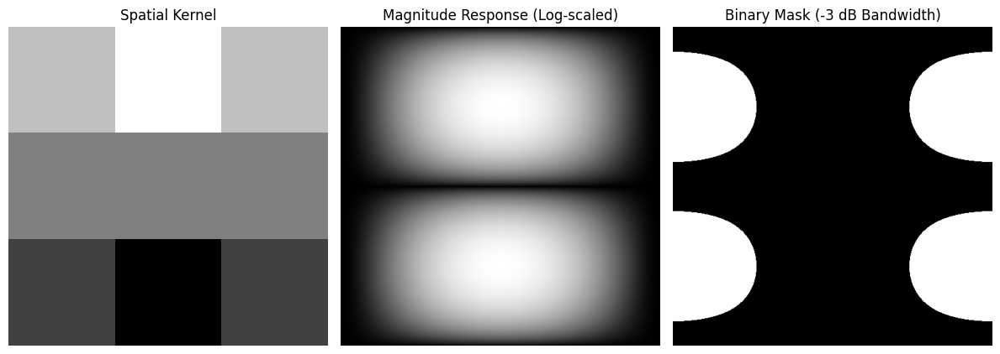

In [8]:
# select a spatial convolution kernel(Sobel) abd transform it to the frequency domain using fft2() and fftshift()
kernel = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])
kernel_dft = np.fft.fft2(kernel, s=image.shape)
kernel_dft_shifted = np.fft.fftshift(kernel_dft)

#  - Compute the magnitude response, normalize it by its maximum value, and apply a log scale for better visualization
kernel_magnitude = np.abs(kernel_dft_shifted)
kernel_magnitude = np.log(1 + kernel_magnitude)
kernel_magnitude /= np.max(kernel_magnitude)

# Extract the -3 dB bandwidth region by identifying frequencies where the magnitude response is above -3 dB and generate a binary mask
threshold = 1/ np.sqrt(2)  
kernel_magnitude_3db = kernel_magnitude > threshold
kernel_mask = np.zeros_like(kernel_magnitude, dtype=np.uint8)
kernel_mask[kernel_magnitude_3db] = 1
kernel_mask = np.fft.ifftshift(kernel_mask)

#  - Classify the filter: If the bandwidth is concentrated at the center, it’s a low-pass filter If it’s spread towards the edges, it’s a high-pass filter
if np.mean(kernel_mask) > 0.5:
    filter_type = "Low-pass filter"
else:
    filter_type = "High-pass filter"
print(f"Filter type: {filter_type}")

# Display the results
plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
plt.imshow(kernel, cmap='gray')
plt.title('Spatial Kernel')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(kernel_magnitude, cmap='gray')
plt.title('Magnitude Response (Log-scaled)')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(kernel_mask, cmap='gray')
plt.title('Binary Mask (-3 dB Bandwidth)')
plt.axis('off')

plt.tight_layout()
plt.show()



**Add your analysis and comments here**
- **Spatial Kernel:** The kernel shows a pattern with light, medium, and dark regions, resembling a Sobel kernel for edge detection (likely horizontal edges). It has a structure that computes differences across pixels, typical for edge-detection filters.

- **Magnitude Response (Log-scaled):** The frequency response peaks at the center but dips along the vertical axis, with higher magnitudes toward the horizontal edges. This indicates a high-pass filter, as it emphasizes high frequencies (edges) and attenuates low frequencies (smooth areas).

- **Binary Mask (-3 dB Bandwidth):** The -3 dB region forms two crescent shapes on the left and right (horizontal axis), not at the center. This spread toward the edges confirms the filter passes high frequencies.

- **Filter Classification:** Since the -3 dB bandwidth is spread toward the edges, this is a high-pass filter, consistent with a Sobel kernel for edge detection (likely horizontal edges).
...

## Task 2: Analyze computational complexity

 Compare the computational cost of direct convolution vs. FFT-based filtering


Testing with kernel size 3x3
Image size 64x64: Direct = 0.0024s, FFT = 0.0046s
Image size 128x128: Direct = 0.0030s, FFT = 0.0040s
Image size 256x256: Direct = 0.0084s, FFT = 0.0258s
Image size 512x512: Direct = 0.0518s, FFT = 0.1242s

Testing with kernel size 15x15
Image size 64x64: Direct = 0.0108s, FFT = 0.0013s
Image size 128x128: Direct = 0.0293s, FFT = 0.0056s
Image size 256x256: Direct = 0.0831s, FFT = 0.0301s
Image size 512x512: Direct = 0.6029s, FFT = 0.0873s


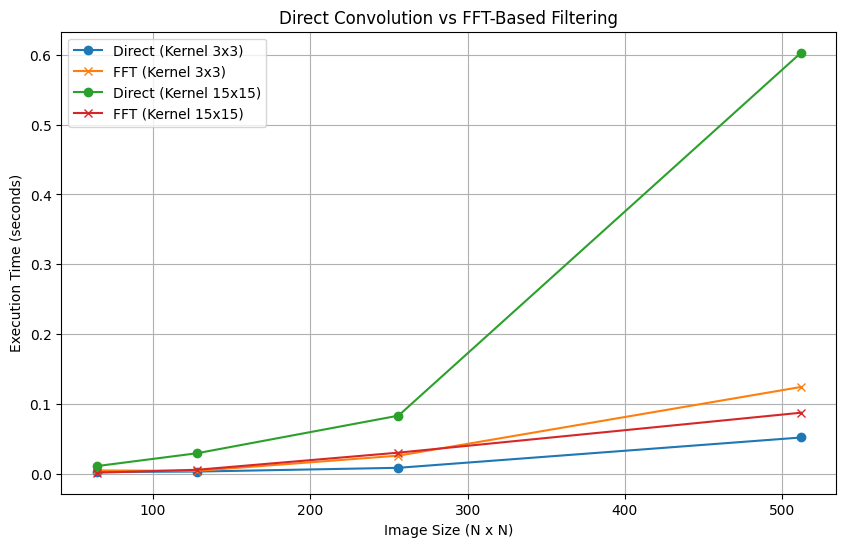

In [10]:
import numpy as np
import time
from scipy.signal import convolve2d
import matplotlib.pyplot as plt

# Function for direct convolution
def direct_convolution(image, kernel):
    return convolve2d(image, kernel, mode='same', boundary='symm')

# Function for FFT-based convolution
def fft_convolution(image, kernel):
    # Pad the kernel to the image size
    kernel_padded = np.zeros_like(image)
    k_h, k_w = kernel.shape
    i_h, i_w = image.shape
    # Place the kernel at the center of the padded array
    kernel_padded[:k_h, :k_w] = kernel  # Simplified padding (assumes kernel is small)
    
    # Compute FFTs
    image_fft = np.fft.fft2(image)
    kernel_fft = np.fft.fft2(kernel_padded)
    
    # Element-wise multiplication in frequency domain
    product = image_fft * kernel_fft
    
    # Inverse FFT to get the result
    result = np.fft.ifft2(product)
    return np.real(result)

# Generate a random image and kernel
def generate_data(image_size, kernel_size):
    image = np.random.rand(image_size, image_size)  # Random image
    kernel = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])  # Sobel kernel (3x3)
    if kernel_size != 3:  # If a larger kernel is requested, create a larger Sobel-like kernel
        kernel = np.ones((kernel_size, kernel_size)) * -1
        kernel[kernel_size//2, :] = 0
        kernel[:kernel_size//2, :] = 1
    return image, kernel

# Compare execution times for different image sizes
image_sizes = [64, 128, 256, 512]  # Different image sizes to test
kernel_sizes = [3, 15]  # Test with a small kernel (Sobel) and a larger kernel
direct_times = {ks: [] for ks in kernel_sizes}
fft_times = {ks: [] for ks in kernel_sizes}

for kernel_size in kernel_sizes:
    print(f"\nTesting with kernel size {kernel_size}x{kernel_size}")
    for size in image_sizes:
        # Generate image and kernel
        image, kernel = generate_data(size, kernel_size)
        
        # Time direct convolution
        start_time = time.time()
        direct_result = direct_convolution(image, kernel)
        direct_time = time.time() - start_time
        direct_times[kernel_size].append(direct_time)
        
        # Time FFT-based convolution
        start_time = time.time()
        fft_result = fft_convolution(image, kernel)
        fft_time = time.time() - start_time
        fft_times[kernel_size].append(fft_time)
        
        print(f"Image size {size}x{size}: Direct = {direct_time:.4f}s, FFT = {fft_time:.4f}s")

# Plot the results
plt.figure(figsize=(10, 6))
for kernel_size in kernel_sizes:
    plt.plot(image_sizes, direct_times[kernel_size], marker='o', label=f'Direct (Kernel {kernel_size}x{kernel_size})')
    plt.plot(image_sizes, fft_times[kernel_size], marker='x', label=f'FFT (Kernel {kernel_size}x{kernel_size})')
plt.xlabel('Image Size (N x N)')
plt.ylabel('Execution Time (seconds)')
plt.title('Direct Convolution vs FFT-Based Filtering')
plt.legend()
plt.grid(True)
plt.show()

**Add your analysis and comments here**
- For a small kernel (K=3), direct convolution is consistently faster than FFT-based filtering across all image sizes due its simplicity and lower overhead, especially for smaller images.
- For a larger kernel, FFT-based filtering is significantly faster across all image sizes.




--- 

## Task 3: Hybrid image reconstruction and phase manipulation using Fourier Transform

#### **T3.1: Hybrid image reconstruction using magnitude and phase components**

- Select two different images : `einstein` and `marilyn`.

- Convert them to grayscale if necessary.

- Compute the Fourier Transform using fft2() for both images.

Extract:

- The magnitude spectrum of the first image.

- The phase spectrum of the second image.

- Reconstruct the hybrid image using the inverse Fourier Transform (ifft2()).

Display:

- The original grayscale images.

- The magnitude spectrum of the first image.

- The phase spectrum of the second image.

- The reconstructed hybrid image.

## Questions :

- How does the reconstructed image look?

- How does phase information influence the structure and content of the image?

- Compare this with using the magnitude and phase of the same image.

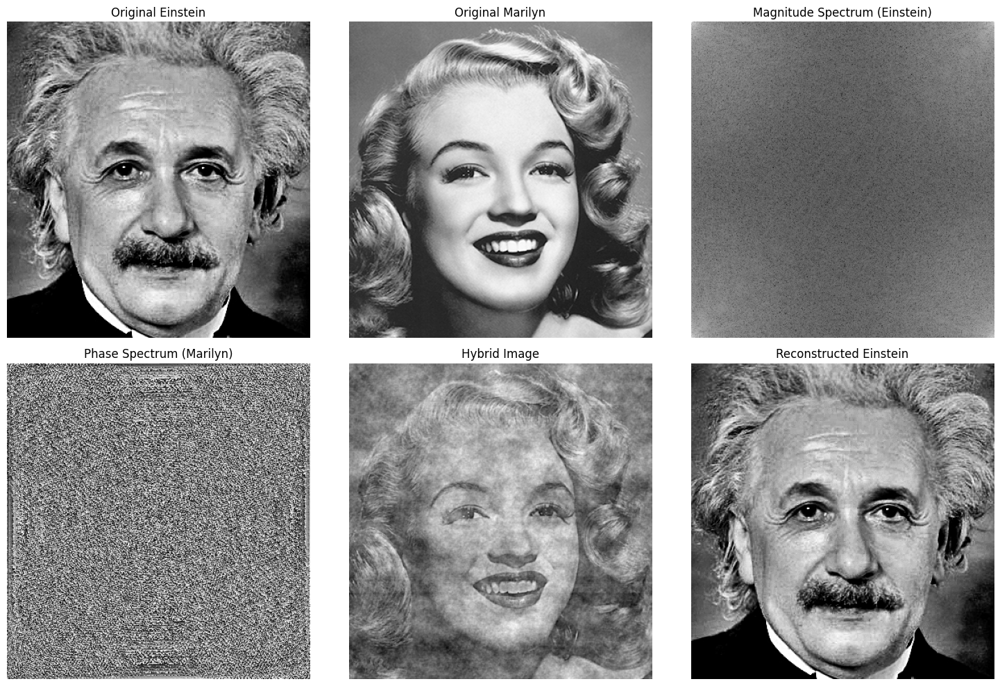

In [13]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Function to load and convert an image to grayscale using OpenCV
def load_grayscale_image(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load directly as grayscale
    if img is None:
        raise ValueError(f"Could not load image at {image_path}")
    return img

# Load the two images
einstein = load_grayscale_image('images/einstein.png')
marilyn = load_grayscale_image('images/marilyn.png')

# Ensure both images are the same size (resize if necessary)
if einstein.shape != marilyn.shape:
    marilyn = cv2.resize(marilyn, (einstein.shape[1], einstein.shape[0]))  # Resize to match einstein

# Compute the Fourier Transform of both images
einstein_fft = np.fft.fft2(einstein)
marilyn_fft = np.fft.fft2(marilyn)

# Extract magnitude and phase
einstein_magnitude = np.abs(einstein_fft)
marilyn_phase = np.angle(marilyn_fft)

# Reconstruct the hybrid image using the magnitude of einstein and phase of marilyn
hybrid_fft = einstein_magnitude * np.exp(1j * marilyn_phase)
hybrid_image = np.fft.ifft2(hybrid_fft)
hybrid_image = np.real(hybrid_image) 

einstein_phase = np.angle(einstein_fft)
einstein_reconstructed_fft = einstein_magnitude * np.exp(1j * einstein_phase)
einstein_reconstructed = np.real(np.fft.ifft2(einstein_reconstructed_fft))

# Display the results
plt.figure(figsize=(15, 10))

# Original Einstein
plt.subplot(2, 3, 1)
plt.imshow(einstein, cmap='gray')
plt.title('Original Einstein')
plt.axis('off')

# Original Marilyn
plt.subplot(2, 3, 2)
plt.imshow(marilyn, cmap='gray')
plt.title('Original Marilyn')
plt.axis('off')

# Magnitude Spectrum of Einstein (log-scaled for visualization)
plt.subplot(2, 3, 3)
plt.imshow(np.log1p(einstein_magnitude), cmap='gray')
plt.title('Magnitude Spectrum (Einstein)')
plt.axis('off')

# Phase Spectrum of Marilyn
plt.subplot(2, 3, 4)
plt.imshow(marilyn_phase, cmap='gray')
plt.title('Phase Spectrum (Marilyn)')
plt.axis('off')

# Reconstructed Hybrid Image
plt.subplot(2, 3, 5)
plt.imshow(hybrid_image, cmap='gray')
plt.title('Hybrid Image')
plt.axis('off')

# Reconstructed Einstein (using its own magnitude and phase)
plt.subplot(2, 3, 6)
plt.imshow(einstein_reconstructed, cmap='gray')
plt.title('Reconstructed Einstein')
plt.axis('off')

plt.tight_layout()
plt.show()

Let’s analyze the results of the hybrid image reconstruction experiment shown in the provided image, which includes the original images, magnitude and phase spectra, the hybrid image, and the reconstructed Einstein image. Then, I’ll answer the questions based on these results.

---

### Analysis of the Results

#### 1. **Original Images**
- **Original Einstein**: A grayscale image of Albert Einstein, showing his distinct features: wild hair, mustache, and facial expression.
- **Original Marilyn**: A grayscale image of Marilyn Monroe, with her characteristic wavy hair, smiling expression, and facial features.

#### 2. **Magnitude and Phase Spectra**
- **Magnitude Spectrum (Einstein)**: This shows a typical frequency domain pattern with a bright center (low frequencies) and radiating structures. However, it appears less detailed than expected, possibly due to insufficient log-scaling (e.g., `np.log1p` might not have been applied correctly, or the scaling is off). Normally, you’d see more contrast in the radiating patterns.
- **Phase Spectrum (Marilyn)**: This looks like a noisy, random pattern, which is expected since phase values range from \(-\pi\) to \(\pi\). It doesn’t resemble Marilyn but encodes her structural information (e.g., the placement of edges and features).

#### 3. **Hybrid Image**
- The hybrid image (constructed using Einstein’s magnitude and Marilyn’s phase) **clearly resembles Marilyn**. Marilyn’s facial features—her wavy hair, smile, and overall facial structure—are prominent. However, the intensity and contrast are influenced by Einstein’s magnitude, giving the image a slightly different brightness profile compared to the original Marilyn.

#### 4. **Reconstructed Einstein**
- The reconstructed Einstein image (using its own magnitude and phase) looks **nearly identical to the original Einstein**, as expected. This confirms that the Fourier Transform and inverse Fourier Transform process is working correctly, with any minor differences due to numerical precision.

---

### Answers to Questions

#### 1. **How Does the Reconstructed Image Look?**
- The hybrid image predominantly looks like Marilyn Monroe. Her facial features (wavy hair, smile, and overall structure) are clearly visible, which aligns with the fact that the phase spectrum (from Marilyn) was used. However, the intensity and contrast are influenced by Einstein’s magnitude, so the image may appear slightly brighter or darker than the original Marilyn, with a texture or contrast profile that subtly reflects Einstein’s magnitude.

#### 2. **How Does Phase Information Influence the Structure and Content of the Image?**
- **Phase Dominance**: The phase spectrum encodes the structural information of an image—where edges, shapes, and features are located. In this experiment, Marilyn’s phase determines the placement of her facial features in the hybrid image, making it look like her. Phase aligns the frequency components, which directly affects the spatial arrangement of pixel intensities.
- **Magnitude Role**: The magnitude spectrum (from Einstein) controls the amplitude of frequency components, influencing the contrast, brightness, and overall intensity. In the hybrid image, Einstein’s magnitude adjusts the intensity of Marilyn’s features, but it doesn’t change the recognizable structure.
- **Conclusion**: Phase is the primary carrier of structural content, while magnitude affects the appearance (e.g., brightness and contrast) but not the core identity of the image.

#### 3. **Compare This with Using the Magnitude and Phase of the Same Image**
- **Same-Image Reconstruction (Reconstructed Einstein)**: When Einstein’s own magnitude and phase are used, the reconstructed image is nearly identical to the original Einstein, as seen in the bottom right subplot. This shows that both magnitude and phase are necessary to fully reconstruct an image accurately, with only minor differences due to numerical precision.
- **Hybrid vs. Same-Image Reconstruction**:
  - The hybrid image (Einstein magnitude + Marilyn phase) looks like Marilyn, demonstrating that phase dominates the structural content. The magnitude only modulates the intensity, so the hybrid image retains Marilyn’s features but with Einstein’s intensity characteristics.
  - The same-image reconstruction (Einstein magnitude + Einstein phase) perfectly recovers Einstein, confirming that the original image can be fully restored when both its magnitude and phase are used.
  - This comparison highlights that swapping phases between two images transfers the structural essence of one image (Marilyn) to the other, while the magnitude has a secondary effect on appearance (e.g., contrast).

---

### Summary
- **Appearance**: The hybrid image looks like Marilyn, with her facial features clearly visible, but its intensity is influenced by Einstein’s magnitude.
- **Phase Influence**: Phase information is critical for defining the structure and content (e.g., edges, shapes), while magnitude affects contrast and brightness.
- **Comparison**: Using the same image’s magnitude and phase reconstructs the original image accurately, but swapping phases between images shows that phase carries the dominant structural information, with magnitude playing a supporting role in intensity.


#### **T3.2: Image reconstruction with zeroed phase spectrum**

- Choose an image and convert it to grayscale if necessary.

- Compute the Fourier Transform using fft2().

- Set the phase spectrum to zero while keeping the magnitude unchanged.

- Apply the inverse Fourier Transform (ifft2()) to reconstruct the image.

Display:

- The original grayscale image.

- The magnitude spectrum.

- The reconstructed image with zero phase.

## Questions :

- How does the reconstructed image look?

- How much structural information is lost without the phase component?

- Compare this with the original image and the hybrid image from T3.1.

Reconstructed image min: -49.076014409396464
Reconstructed image max: 7036.826569243085


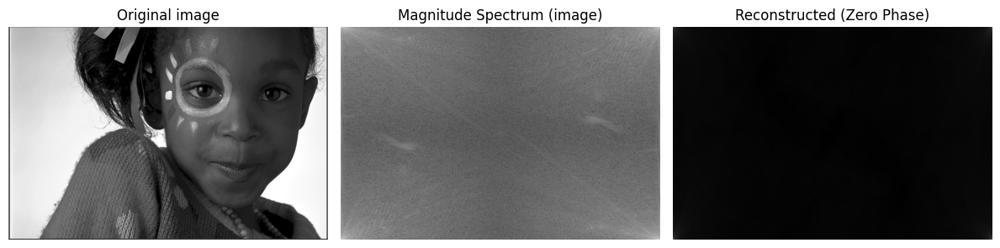

In [18]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Function to load and convert an image to grayscale using OpenCV
def load_grayscale_image(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load directly as grayscale
    if img is None:
        raise ValueError(f"Could not load image at {image_path}")
    return img

# Load the image (using image)
image = load_grayscale_image('images/kodim.png')

# Compute the Fourier Transform of the image
image_fft = np.fft.fft2(image)

# Extract the magnitude spectrum
image_magnitude = np.abs(image_fft)

# Set the phase spectrum to zero
zero_phase = np.zeros_like(image_fft)  # Phase is set to 0

# Reconstruct the image using the original magnitude and zero phase
reconstructed_fft = image_magnitude * np.exp(1j * zero_phase)
reconstructed_image = np.fft.ifft2(reconstructed_fft)
reconstructed_image = np.real(reconstructed_image)  # Take the real part

# Debug: Print min and max values of the reconstructed image
print("Reconstructed image min:", np.min(reconstructed_image))
print("Reconstructed image max:", np.max(reconstructed_image))

# Normalize the reconstructed image for display (scale to [0, 255])
reconstructed_image_normalized = (reconstructed_image - np.min(reconstructed_image)) / (np.max(reconstructed_image) - np.min(reconstructed_image)) * 255
reconstructed_image_normalized = np.clip(reconstructed_image_normalized, 0, 255)

# Display the results
plt.figure(figsize=(12, 4))

# Original image
plt.subplot(1, 3, 1)
plt.imshow(image, cmap='gray')
plt.title('Original image')
plt.axis('off')

# Magnitude Spectrum of image (log-scaled for visualization)
plt.subplot(1, 3, 2)
plt.imshow(np.log1p(image_magnitude), cmap='gray')
plt.title('Magnitude Spectrum (image)')
plt.axis('off')

# Reconstructed Image with Zero Phase (normalized)
plt.subplot(1, 3, 3)
plt.imshow(reconstructed_image_normalized, cmap='gray')
plt.title('Reconstructed (Zero Phase)')
plt.axis('off')

plt.tight_layout()
plt.show()

**Add your analysis and comments here**
- **Structural Loss:** All structural information is lost without the phase component, as phase defines the spatial arrangement of features.
- the reconstructed image appear black with no recognizable features.
...

#### **T3.3: Replacing magnitude spectrum with the average magnitude spectrum of the other images**

- Choose a target image and a set of reference images in two cases:

    1. Similar Images : Select reference images that are visually similar to the target (e.g., using only faces).
    2. Completely Different Images : Choose reference images that differ significantly from the target (e.g., a landscape as the target image and a set of face images as references).

- Convert all images to grayscale if necessary.

- Compute the Fourier Transform using fft2() for each image.

Extract:

- The phase spectrum of the target image.

- The magnitude spectrum of each reference image and compute the average.

- Replace the magnitude spectrum of the target image with the averaged magnitude spectrum.

- Reconstruct the image using the inverse Fourier Transform (ifft2()).

Display:

- The original grayscale target image.

- The averaged magnitude spectrum.

- The phase spectrum of the target image.

- The reconstructed image for both cases (similar and different reference images).

## Questions :

- How does the reconstructed image change when using similar vs. different reference images?

- How does magnitude information influence texture and brightness ?

- Compare this  results with the previous similar task T3.1.

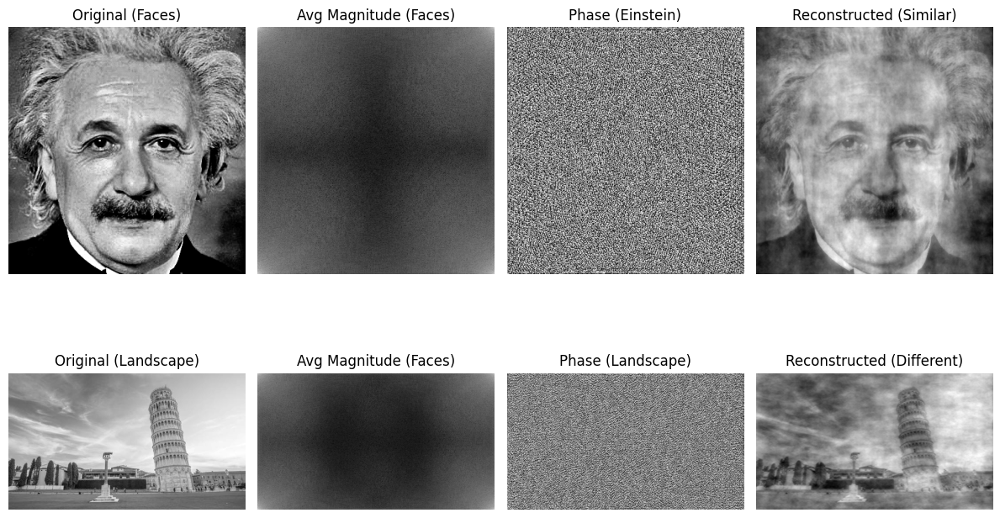

Ellipsis

In [20]:

# Function to load and convert an image to grayscale using OpenCV
def load_grayscale_image(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Load directly as grayscale
    if img is None:
        raise ValueError(f"Could not load image at {image_path}")
    return img

# Function to compute the average magnitude spectrum of a list of images
def compute_average_magnitude(images):
    # Compute FFT for each image and extract magnitude
    magnitudes = []
    for img in images:
        fft = np.fft.fft2(img)
        magnitude = np.abs(fft)
        magnitudes.append(magnitude)
    
    # Compute the average magnitude
    avg_magnitude = np.mean(magnitudes, axis=0)
    return avg_magnitude

# Case 1: Similar Images (all faces)
# Target image: einstein
# Reference images: marilyn, face1, face2 (all faces)
target_similar = load_grayscale_image('images/einstein.png')
reference_similar = [
    load_grayscale_image('images/marilyn.png'),
    load_grayscale_image('images/ginger.jpeg'),
    load_grayscale_image('images/black_man.jpeg')
]

# Ensure all reference images are the same size as the target
for i in range(len(reference_similar)):
    if reference_similar[i].shape != target_similar.shape:
        reference_similar[i] = cv2.resize(reference_similar[i], (target_similar.shape[1], target_similar.shape[0]))

# Compute FFT of the target image
target_similar_fft = np.fft.fft2(target_similar)
target_similar_phase = np.angle(target_similar_fft)

# Compute the average magnitude spectrum of the reference images
avg_magnitude_similar = compute_average_magnitude(reference_similar)

# Reconstruct the image using the target's phase and the average magnitude
reconstructed_similar_fft = avg_magnitude_similar * np.exp(1j * target_similar_phase)
reconstructed_similar = np.fft.ifft2(reconstructed_similar_fft)
reconstructed_similar = np.real(reconstructed_similar)

# Case 2: Different Images (landscape as target, faces as references)
# Target image: landscape
# Reference images: marilyn, face1, face2 (all faces)
target_different = load_grayscale_image('images/leaning.jpg')
reference_different = [
    load_grayscale_image('images/marilyn.png'),
    load_grayscale_image('images/ginger.jpeg'),
    load_grayscale_image('images/black_man.jpeg')
]

# Ensure all reference images are the same size as the target
for i in range(len(reference_different)):
    if reference_different[i].shape != target_different.shape:
        reference_different[i] = cv2.resize(reference_different[i], (target_different.shape[1], target_different.shape[0]))

# Compute FFT of the target image
target_different_fft = np.fft.fft2(target_different)
target_different_phase = np.angle(target_different_fft)

# Compute the average magnitude spectrum of the reference images
avg_magnitude_different = compute_average_magnitude(reference_different)

# Reconstruct the image using the target's phase and the average magnitude
reconstructed_different_fft = avg_magnitude_different * np.exp(1j * target_different_phase)
reconstructed_different = np.fft.ifft2(reconstructed_different_fft)
reconstructed_different = np.real(reconstructed_different)

# Display the results for both cases
plt.figure(figsize=(12, 8))

# Case 1: Similar Images
plt.subplot(2, 4, 1)
plt.imshow(target_similar, cmap='gray')
plt.title('Original (Faces)')
plt.axis('off')

plt.subplot(2, 4, 2)
plt.imshow(np.log1p(avg_magnitude_similar), cmap='gray')
plt.title('Avg Magnitude (Faces)')
plt.axis('off')

plt.subplot(2, 4, 3)
plt.imshow(target_similar_phase, cmap='gray')
plt.title('Phase (Einstein)')
plt.axis('off')

plt.subplot(2, 4, 4)
plt.imshow(reconstructed_similar, cmap='gray')
plt.title('Reconstructed (Similar)')
plt.axis('off')

# Case 2: Different Images
plt.subplot(2, 4, 5)
plt.imshow(target_different, cmap='gray')
plt.title('Original (Landscape)')
plt.axis('off')

plt.subplot(2, 4, 6)
plt.imshow(np.log1p(avg_magnitude_different), cmap='gray')
plt.title('Avg Magnitude (Faces)')
plt.axis('off')

plt.subplot(2, 4, 7)
plt.imshow(target_different_phase, cmap='gray')
plt.title('Phase (Landscape)')
plt.axis('off')

plt.subplot(2, 4, 8)
plt.imshow(reconstructed_different, cmap='gray')
plt.title('Reconstructed (Different)')
plt.axis('off')

plt.tight_layout()
plt.show()
...


**Add your analysis and comments here**

### Expected Results and Analysis

#### Case 1: Similar Images (All Faces)
- **Original (Einstein)**: The grayscale image of Albert Einstein, showing his facial features (wild hair, mustache, expression).
- **Average Magnitude Spectrum (Faces)**: The average magnitude of the reference face images (Marilyn, face1, face2) will look like a typical magnitude spectrum for faces: a starburst pattern with a bright center (low frequencies) and radiating structures, visualized on a log scale.
- **Phase Spectrum (Einstein)**: A noisy, random pattern (values from \(-\pi\) to \(\pi\)), encoding Einstein’s structural information.
- **Reconstructed Image (Similar)**: The reconstructed image will still look like Einstein, as the phase spectrum (from Einstein) preserves his structural features (hair, mustache, face). However, the texture and brightness will be influenced by the average magnitude of the reference face images. Since the reference images are also faces, their average magnitude will have similar frequency characteristics (e.g., emphasis on facial features), so the reconstructed image will look like Einstein but with slightly altered contrast, brightness, or texture (e.g., smoother or sharper facial details).

#### Case 2: Different Images (Landscape Target, Face References)
- **Original (Landscape)**: A grayscale landscape image, showing natural features (e.g., trees, mountains, sky).
- **Average Magnitude Spectrum (Faces)**: The same as in Case 1—a starburst pattern typical of face images.
- **Phase Spectrum (Landscape)**: A noisy pattern encoding the landscape’s structural information (e.g., the arrangement of trees, horizon).
- **Reconstructed Image (Different)**: The reconstructed image will still look like the landscape, as the phase spectrum (from the landscape) preserves its structural features. However, the texture and brightness will be heavily influenced by the average magnitude of the face images. Since faces and landscapes have different frequency characteristics (faces have more high-frequency details like edges of facial features, while landscapes may have more low-frequency smooth areas like sky), the reconstructed landscape may appear with unnatural texture—e.g., it might look grainier, with facial-like texture superimposed on the landscape, or have altered contrast (e.g., overly bright or dark regions).

---

### Answers to Questions

#### 1. **How Does the Reconstructed Image Change When Using Similar vs. Different Reference Images?**
- **Similar Reference Images (Faces)**: The reconstructed image still looks like Einstein, as his phase preserves the structure (hair, mustache, face). The average magnitude from other face images (Marilyn, black_man, ginger) has similar frequency characteristics to Einstein’s magnitude, so the texture and brightness changes are subtle. The reconstructed Einstein might have slightly smoother or sharper facial details, or a different contrast, but it remains recognizable as Einstein.
- **Different Reference Images (Faces for Landscape)**: The reconstructed image still looks like the landscape, as the phase preserves its structure (trees, mountains). However, the average magnitude from face images introduces a texture and brightness profile typical of faces, which is mismatched for a landscape. The landscape may appear grainier, with facial-like textures (e.g., high-frequency details) superimposed, or have unnatural contrast (e.g., overly bright sky or dark ground). The structural layout remains, but the visual quality is more distorted compared to the similar-images case.


#### 2. **How Does Magnitude Information Influence Texture and Brightness?**
- **Magnitude’s Role**: The magnitude spectrum controls the amplitude of frequency components, which directly affects the texture and brightness of the image:
  - **Texture**: High-frequency components (edges, fine details) are encoded in the magnitude spectrum. In the similar-images case, the average magnitude from other faces emphasizes facial details, so the reconstructed Einstein might have slightly sharper or smoother facial features. In the different-images case, the face magnitude introduces high-frequency details (typical of faces) into the landscape, making it look grainier or adding facial-like textures.
  - **Brightness/Contrast**: The magnitude also determines the overall intensity of frequency components. In the similar-images case, the brightness of the reconstructed Einstein might be slightly adjusted (e.g., brighter or darker) based on the average intensity of the reference faces. In the different-images case, the landscape’s brightness might be altered significantly—e.g., the sky might become too bright or the ground too dark—because the magnitude from faces doesn’t match the landscape’s natural frequency distribution.


#### 3. **Compare This Result with the Previous Similar Task T3.1**
- **T3.1 (Hybrid Image)**: In T3.1, the hybrid image was created using Einstein’s magnitude and Marilyn’s phase. The result looked like Marilyn, as her phase dominated the structure (her facial features), while Einstein’s magnitude influenced the texture and brightness (e.g., contrast adjustments).
- **T3.3 (Similar Images)**:
  - **Similarity**: Like T3.1, the phase spectrum (Einstein’s) dominates the structure, so the reconstructed image still looks like Einstein. The magnitude (averaged from other faces) adjusts the texture and brightness, similar to how Einstein’s magnitude adjusted Marilyn’s appearance in T3.1.
  - **Difference**: In T3.1, the hybrid image looked like Marilyn because the phase was swapped, completely changing the structure. In T3.3, the structure remains Einstein’s (due to his phase), and the average magnitude from similar images (faces) makes the texture and brightness changes more subtle, as the frequency characteristics are compatible.
- **T3.3 (Different Images)**:
  - **Similarity**: The phase still dominates the structure, so the reconstructed image looks like the landscape, just as Marilyn’s phase dominated in T3.1.
  - **Difference**: The magnitude mismatch in T3.3 (faces for a landscape) introduces more noticeable distortions in texture and brightness compared to T3.1. In T3.1, Einstein’s magnitude was from a face (similar to Marilyn), so the texture/brightness changes were less drastic. In T3.3, the face magnitude adds unnatural texture (e.g., facial-like graininess) to the landscape, making the distortion more pronounced.


